# Cinematic frame generator

## Intro

I am Amit Hendin (316384817), computer science student passionate about neural network and machine learning algorithms. In this project I attempt to create a neural network that is able to generate new frames of a tv show based existing episodes available. For this task I chose the show Tom and Jerry, Tom and Jerry is an animated series from 1940 which has been running on and off for many years and even now stills runs.

The show features comic fights between an iconic set of adversaries, a house cat (Tom) and a house mouse (Jerry). The plots of many shorts are often set in the backdrop of a house, centering on Tom (who is often enlisted by a human) trying to capture Jerry, and the mayhem and destruction that follows. Tom rarely succeeds in catching Jerry, mainly because of Jerry's cleverness, cunning abilities, and luck. However, on several occasions, they have displayed genuine friendship and concern for each other's well-being.

I chose this show due to it's simple and undetailed visuals (especially being an animated series), and rather the profound movements of the characters, I expected these attributes of the video will lend themselfs well to being distctly characterised by the weight of a neural network algorithm. 

### The plan

The plan to achieve this is to split it up into two tasks, first, we must be able to "summaries" and identify the most significant features (or pixel) of the frame, and second we must learn how these features affect each other over time. In simpler terms, suppose we have a pixel x, suppose we identified, using a netural network, that this pixel is a significat feature of the frame, we now want to know how the pixel x in frame i affects the pixel x in frame i+1, how the pixel x in frame i+1 affects pixel x in frame i+2 and so on.
The idea is to have the network learn the pattern of pixels that make up a frame and then learn the pattern of frames that make up the video.
For the first task we will use an autoencoder with convolutional layers (i.e. convolutional autoencoder) since the autoencoder is trained using unlabeled data and essentially it performs a sort of PCA on the many many features of a single frame. This "PCA" comes in the form of the autoencoders latent space which will give us a linear space of vectors in which each feature is a significant feature of the full frame pixel space. For the second part we will use an LSTM (long short term memory) that will learn the latent vectors produced by the encoder of the autoencoder, the lstm is a recurrent nueral network that is able to learn the relationship between vectors that in a sequential series and is able to find a pattern in the sequence between the vectors.

Once these two steps have been achieved we can combine the neural networks into a convolutional lstm where we can feed it a sequence of frames and get in result the next predicted frame.

## Exploratory Data Analisys (EDA)

Before we get to coding and training the network we should begin by analysing the data set we are going to work on. This dataset is a plain episode of Tom and Jerry taken from the YouTube channel of Warner Bros. in the mp4 format.
We begin by including the OpenCV2 image processing library to help us read the file and decond the frames from it.            

In [1]:
# step 1
import numpy as np
import cv2
import matplotlib.pyplot as plt
import torch.nn.functional as F

### General properties of the data

Next we examine the video properties (number of frames, frame rate, image resolution, and so on...) and print a few sample frames. We will resized the frames from their original size to a move manageable 128x128 resolution.

frame width: 1920.0
frame height: 1080.0
frame count: 32526
frames per second: 23.976023976023978
bitrate: 2324.0
length of video: 0:22:22


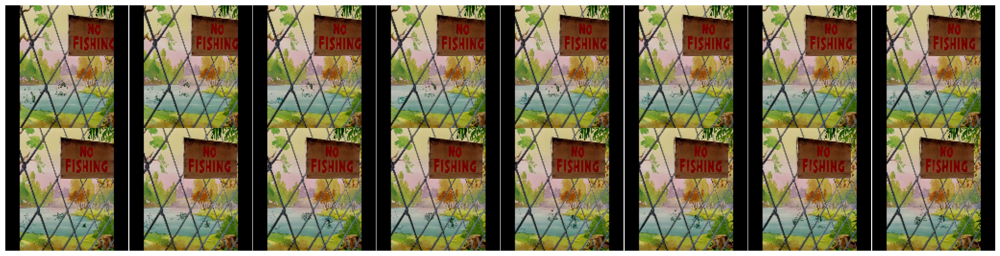

In [2]:
# step 2
VIDEO_PATH = '../data/tom_and_jerry_22_37_yt_wb.mp4'

cap = cv2.VideoCapture(VIDEO_PATH)

print('frame width:', cap.get(cv2.CAP_PROP_FRAME_WIDTH))
print('frame height:', cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print('frame count:', total_frames)
print('frames per second:', cap.get(cv2.CAP_PROP_FPS))
print('bitrate:', cap.get(cv2.CAP_PROP_BITRATE))
video_length_seconds = cap.get(cv2.CAP_PROP_FRAME_COUNT)/cap.get(cv2.CAP_PROP_FPS)
video_length_minutes = int(video_length_seconds // 60)
video_length_hours = int(video_length_minutes // 60)
video_length_seconds = int(video_length_minutes % 60)
print('length of video:',  str(video_length_hours)+':'+str(video_length_minutes)+':'+str(video_length_seconds))

fig, ax = plt.subplots(nrows=2, ncols=8, sharex=True, sharey=True, figsize=(24, 6))
# Loop through each frame
for i in range(2*8):
    # Read the frame
    ret, frame = cap.read()
    # If the frame was read successfully
    if ret:
        # Resize the frame to 128x128
        resized_frame = cv2.resize(frame, (128, 128))
        resized_frame = cv2.cvtColor(resized_frame, cv2.COLOR_BGR2RGB)
        x = i // 8
        y = i % 8
        ax[x,y].imshow(resized_frame)
        ax[x,y].axis('off')
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

Just by looking at these numbers we can gather that even this rather short 22 minute episode contains no less than 32,526 individual frames each with 1920x1080 pixels with each pixel having 3 color channels, this works out to a staggering 32,526x1920x1080x3 = 208,660,795,200 floating point numbers which is much more than the average non-supercomputer can handle within it's memory at once, even working on a 100 frames at a time with still a massive size of data which means we will have to begin summarising right away. The best way to do this without much work would be to resize the frams to a lower resolution, say 128x128. next we will run the following exploraroty calculations of a subset of frames to save time and quickly get a feel for the data.

### Color space of a frame

Now that we can see what kind the size and scope of the data we are working with, we can begin to analise some basic statistics about the frames themselves.
We will observe now the color distribution of all the frames in the video by looping over the frames, calculating a histogram of colors for each frame and then sum those histograms to get the color historgram of the entire video. 

We omit exclude the pixels that have zero values ince in a frame there is a significant amount of pixels that have zero on one of the channels which will distort our plot. This can be expected as the color contrast on animated videos, especially ones meant for younger audience, commonly feature strong vibrant colors that lean heavly on one channel or the other. From this we gather that normalization will be a necessary step in order to generalize the data. We plot the colors after normalization.

Processed 5000/5000 frames

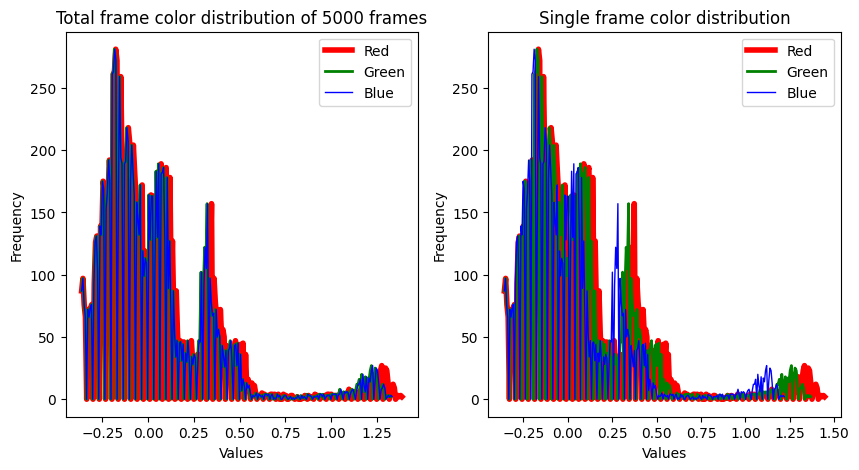

In [4]:
def calcHist(frame, bins=256):
    red, green, blue = frame[:,:,0], frame[:,:,1], frame[:,:,2]
    _, hist_red = np.histogram(red.flatten(), bins=bins)
    _, hist_green = np.histogram(green.flatten(), bins=bins)
    ax, hist_blue = np.histogram(blue.flatten(), bins=bins)
    
    return ax, np.array([hist_red, hist_green, hist_blue])

def plotHist(ax, hist, bins):
    red, = ax.plot( hist[0, : bins.shape[0] ], bins, label='Red', color='Red', linewidth=4)
    green, = ax.plot( hist[1, : bins.shape[0] ], bins, label='Green', color='Green', linewidth=2)
    blue, = ax.plot( hist[2, : bins.shape[0] ], bins, label='Blue', color='Blue', linewidth=1)
    
    ax.legend(handles=[red, green, blue])
    
    ax.set_xlabel('Values')
    ax.set_ylabel('Frequency')

def normalize_tensor(tensor, target_mean, target_std):
    current_mean = np.mean(tensor)
    current_std = np.std(tensor)
    if current_std != 0 and current_std is not np.nan:
        normalized_tensor = (tensor - current_mean) / current_std
        normalized_tensor = normalized_tensor * target_std + target_mean
    else:
        normalized_tensor = tensor
    return normalized_tensor


hist_total = None
hist_bins = None
hist_first = None

num_frames = 5000
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
for i in range(num_frames):
    ret, frame = cap.read()
    if not ret: break
    
    frame = cv2.resize(frame, (128, 128))
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    hist_bins, frame_hist = calcHist(frame)
    
    if hist_total is None:
        hist_total = frame_hist
        hist_first = np.copy(frame_hist)
    else:
        hist_total = hist_total + frame_hist
    
    if np.random.randint(low=1,high=100) == 8:
        print('\rProcessed {}/{} frames'.format(i, num_frames), end='')
print('\rProcessed {}/{} frames'.format(num_frames, num_frames), end='')

hist_total /= num_frames

NORM_STATS = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

hist_total = normalize_tensor(hist_total.T, *NORM_STATS).T
hist_first = normalize_tensor(hist_first.T, *NORM_STATS).T

fig, (ax_total, ax_single) = plt.subplots(1, 2, figsize=(10, 5))
hist_bins = hist_bins[1:]
plotHist(ax_total, hist_total, hist_bins)
ax_total.set_title(f'Total frame color distribution of {num_frames} frames')

plotHist(ax_single, hist_first, hist_bins)
ax_single.set_title('Single frame color distribution')

plt.show()

### Frame sequence color space

In order to visualize the way this color space changes over time, we will plot a series of frames to check if there is indeed a clear pattern of pixels. 
First we render the frames to images and then plot those images to see the changing color space.

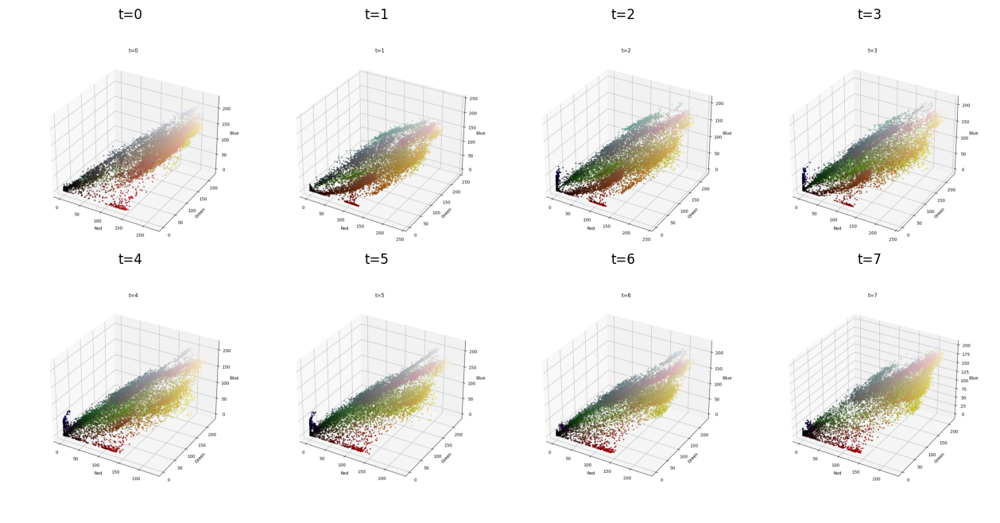

In [4]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import colors

num_frames = 8
images = []
skip = 24
cap.set(cv2.CAP_PROP_POS_FRAMES, 256)
i=0
while i<num_frames*skip:
    ret, frame = cap.read()
    if not ret: break
    frame = cv2.resize(frame, (128, 128))
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    images.append(frame)
    i += skip
    cap.set(cv2.CAP_PROP_POS_FRAMES, i)

for idx, image in enumerate(images):
    r, g, b = image[:,:,0], image[:,:,1], image[:,:,2]
    
    image_colors = image.reshape(128*128, 3)
    norm = colors.Normalize(vmin=-1.,vmax=1.)
    norm.autoscale(image)
    image_colors = norm(image_colors).tolist()
    
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(1,1,1, projection="3d")
    ax.scatter(r.flatten(), g.flatten(), b.flatten(), facecolors=image_colors, marker=".")
    ax.set_xlabel("Red")
    ax.set_ylabel("Green")
    ax.set_zlabel("Blue")
    ax.set_title(f"t={idx}")

    plt.savefig(f"../plots/color_plot_{idx}.png")
    plt.close(fig)
    
fig, axes = plt.subplots(nrows=2, ncols=4,sharex=True, sharey=True, figsize=(16, 8))

for idx in range(num_frames):
    img = cv2.imread(f"../plots/color_plot_{idx}.png")
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

    # Get the corresponding axis object from the grid
    ax = axes.flatten()[idx]
    # Display the image
    ax.imshow(img)
    ax.set_title(f"t={idx}")
    ax.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

As we can see, even by sampling 1 in every 24 frames along the timeline, the clusters of pixel change very slowly over time in the color space and at certain frames we see a sharp change in on the clusters, this may indicate that the  "camera" has panned to a different part of the scene meaning as we may have been looking at Tom moving about a room and then quickly panned to Jerry doing something else in another room. 

We will also take a look at the mean and variance of the colors of each frame to better understand what kind of preprocessing might be required.

In [8]:
frame_color_mean = []
frame_color_var = []

cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
ret, frame = cap.read()
while ret:
    frame = cv2.resize(frame, (128, 128))
    frame = frame.reshape(128*128, 3)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    avg = np.mean(frame,axis=0)
    var = np.var(frame, axis=0)
    
    frame_color_mean.append(avg)
    frame_color_var.append(avg)
    
    ret, frame = cap.read()

In [9]:
print("Frame color average and variance")
np.mean(frame_color_mean, axis=0), np.var(frame_color_var, axis=0)

Frame color average and variance


(array([[ 97.08333809,  97.08333809,  97.08333809],
        [102.76559284, 102.76559284, 102.76559284],
        [ 96.60296133,  96.60296133,  96.60296133]]),
 array([[ 947.20773419,  947.20773419,  947.20773419],
        [ 781.82112177,  781.82112177,  781.82112177],
        [1106.70722729, 1106.70722729, 1106.70722729]]))

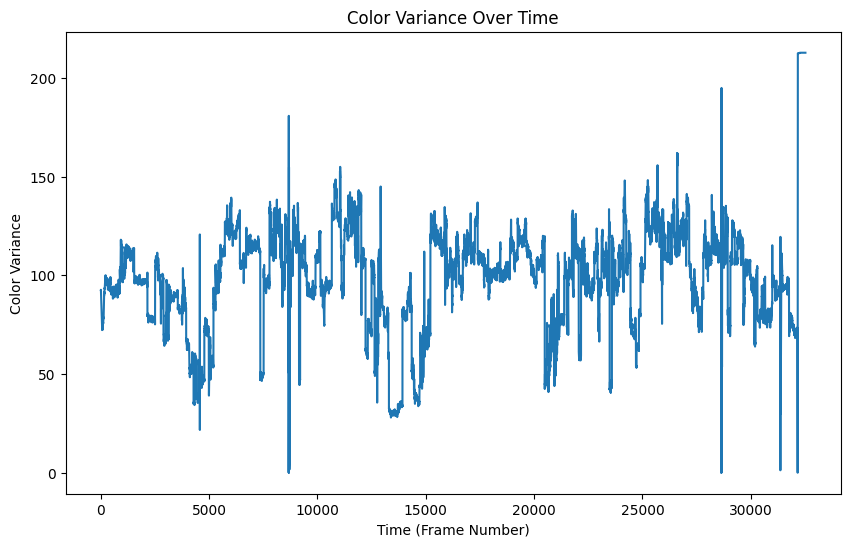

In [17]:
color_variances = []
times = list(range(len(frame_color_var)))

plt.figure(figsize=(10, 6))
plt.plot(times, np.mean(frame_color_var, axis=(1,2)) )
plt.xlabel('Time (Frame Number)')
plt.ylabel('Color Variance')
plt.title('Color Variance Over Time')
plt.show()

We can also see that the colors are fairly balanced since the average values of each channel are very close considering the amount pixels stored in 32k 128x128 frames. In addition we see significant variance over time which suggests learning algorithms should be able to learn this data quite well. 

### Clustering
To try and better understand the relationship between the frames we will try to cluster the frames based on their calculated feature vector. There are various methods we can use to convert the frame into feature vectors. We will start by using the [Shi Tomasi Corner Detection](https://docs.opencv.org/4.x/d4/d8c/tutorial_py_shi_tomasi.html), a method for capturing key points in the image by identifying corners. We choose thie on since it allows us to specifiy the number of features we want to obtain from an image which could be useful since most clustering methods don't do well with large amount of features.
We first visualize these points on a random frame.

random frame index 22314


array([[ 33., 104.],
       [ 47.,  93.],
       [ 74., 113.],
       [ 43.,  80.],
       [ 33.,  73.]], dtype=float32)

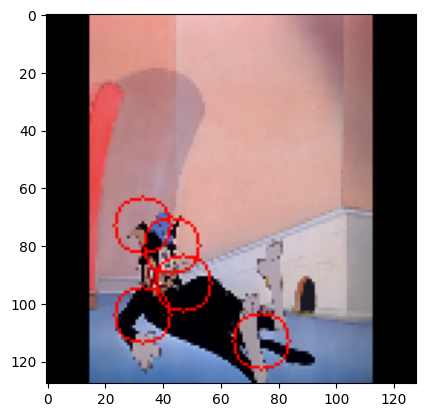

In [36]:
rand_idx = np.random.randint(0, total_frames)
print('random frame index',rand_idx)

cap.set(cv2.CAP_PROP_POS_FRAMES, rand_idx)
ret, frame = cap.read()
frame = cv2.resize(frame, (128,128))
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

gray = np.float32(cv2.cvtColor(frame,cv2.COLOR_RGB2GRAY))
num_corners = 5
corners = cv2.goodFeaturesToTrack(gray,num_corners,0.01,10)
for c in corners:
    center = np.intp(c.flatten())
    cv2.circle(frame, center, 10, (255,0,0) )

plt.imshow(frame)
corners.squeeze()

Next, we will simply convert our video  (or a portion of it) to feature vectors using Shi Tomasi

In [51]:
NUM_FEATURES = 5

frame_features = np.zeros((total_frames, NUM_FEATURES*2))
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
ret, frame = cap.read()
i = 0
while ret:
    frame = cv2.resize(frame, (128,128))
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    gray = np.float32(cv2.cvtColor(frame,cv2.COLOR_RGB2GRAY))
    features = cv2.goodFeaturesToTrack(gray, NUM_FEATURES, 0.01, 10)
    if features is not None:
        features = features.flatten()
        features = np.pad(features, (0, frame_features.shape[1] - features.shape[0]), 'constant')
        frame_features[i]=features
    i += 1
    ret, frame = cap.read()
    print('\rProcessed {}/{} frames'.format(i, total_frames), end='')
    
frame_features.shape

Processed 32526/32526 frames

(32526, 10)

Now we write a function to take in this data and perform cluster analysis on it. We will use the K-means algorithm due to it's simplicity. We will also compute various metrics about the resulting clusters to measure thier quality such as intra and inter cluster distances and [Dunn index](https://en.wikipedia.org/wiki/Dunn_index). We will then render a grid of scatter plots to show various axis against each other in order to visualize the separation between clusters.

In [3]:
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances

def dunn_index(X, labels):
    n_clusters = np.unique(labels).shape[0]
    cluster_distances = np.zeros((n_clusters, n_clusters))
    cluster_diameters = np.zeros(n_clusters)
    
    # Calculate inter-cluster distances
    for i in range(n_clusters):
        for j in range(i+1, n_clusters):
            cluster_distances[i, j] = np.linalg.norm(X[labels == i].mean(axis=0) - X[labels == j].mean(axis=0))
    
    # Calculate cluster diameters
    for i in range(n_clusters):
        cluster_diameters[i] = pairwise_distances(X[labels == i]).max()
    
    min_cluster_distance = np.min(cluster_distances[cluster_distances != 0])
    max_cluster_diameter = cluster_diameters.max()
    
    if max_cluster_diameter == 0:
        return np.inf
    
    return min_cluster_distance / max_cluster_diameter

def cluster_analysis(data, K, plot=True):
    kmeans = KMeans(n_clusters=K, n_init="auto")
    kmeans.fit(data)
    data_kmeans = kmeans.predict(data)
    centers = kmeans.cluster_centers_
    
    intra_cluster_dist = np.zeros((K,))
    
    for i in range(K):
        center = centers[i]
        for point in data[data_kmeans == i]:
             intra_cluster_dist[i] += np.linalg.norm(center - point)
        intra_cluster_dist[i] /= len(data[data_kmeans == i])
    intra_cluster_dist = np.round(intra_cluster_dist, 4)
    
    print("intra cluster distance",intra_cluster_dist)
    
    inter_cluster_dist = []
    for i in range(0,K-1):
        for j in range(i+1,K):
            inter_cluster_dist.append( np.linalg.norm(centers[i] - centers[j]) )
    inter_cluster_dist = np.round(np.array(inter_cluster_dist), 4)
    
    print("inter cluster distance",inter_cluster_dist)
    
    dunn_idx = dunn_index(data, data_kmeans)
    print("Dunn index", dunn_idx)
    
    if not plot:
        return data_kmeans, centers
    
    n = data.shape[1]
    sqr_n = int(np.sqrt(n))
    
    fig, ax = plt.subplots(nrows=sqr_n, ncols=sqr_n, figsize=(12, 12))
    for x in range(sqr_n):
        for y in range(sqr_n):
            if x != y:
                ax[x,y].scatter(data[:, x], data[:, y], c = data_kmeans, s=2, cmap='viridis')
                ax[x,y].scatter(centers[:, x], centers[:, y], c = 'black', s=100)
                ax[x,y].axis('off')
                ax[x,y].set_title(f"{x} by {y}")
    
    plt.show()  

intra cluster distance [75.7111 69.2131 67.4681 68.9322 70.6978]
inter cluster distance [ 90.4552 106.0155  57.9342  64.9785  58.4771  56.5986  80.4198  69.3177
  57.4476  61.1097]
Dunn index 0.22337869692371648


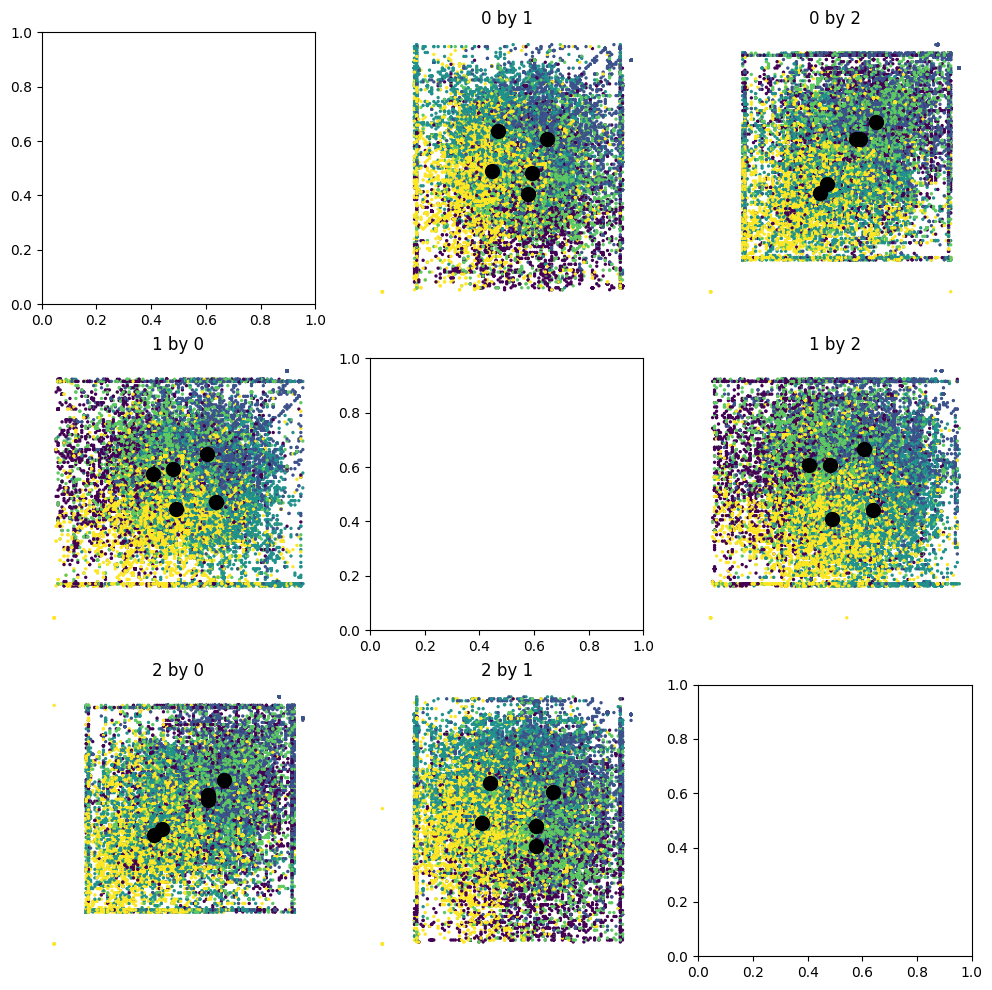

In [76]:
cluster_analysis(frame_features, 5)

As we can see from the plots, the separation is rather poor, a result which is also backed up by the intra cluster distance which is rather close to the inter cluster distance which means points are very close to centers of clusters they don't belong too. We can try increasing the number of features but that is unlikely to generate greater separation between the frames.
From this we gather that we do not see any evidence to suggest there is such a grouping to separate the frames into clusters but other methods [Histogram of gradients](https://en.wikipedia.org/wiki/Histogram_of_oriented_gradients) or [SIFT feature extraction](https://en.wikipedia.org/wiki/Scale-invariant_feature_transform).

We know from common knowledge (and by simply watching the video) that an episode of a show is usually divided into scenes where each scene is a sequence of frames that describe a certain action or event happening in the show. An episode is then comprised of a series of scenes, each taking place in the same or different settings. From this we expect to be able to group divide the series of frames into scenes and then be able to analys the similarity of frames within the scene.
Seeing the results of clustering using conventional feature extraction methods leads us to the conclusion we need better features in order to cluster this dataset by similarity. We will use the well-known VGG16 nueral network model to extract features from our images in the hope that those features will be meaningful enough to group the frames by similarity.

### VGG16

VGG-16 is a convolutional neural network (CNN) architecture that was proposed by the Visual Geometry Group (VGG) at the University of Oxford. It is characterized by its depth, consisting of 16 layers, including 13 convolutional layers and 3 fully connected layers. VGG-16 is renowned for its simplicity and effectiveness, as well as its ability to achieve strong performance on various computer vision tasks, including image classification and object recognition. The model’s architecture features a stack of convolutional layers followed by max-pooling layers, with progressively increasing depth. This design enables the model to learn intricate hierarchical representations of visual features, leading to robust and accurate predictions. Despite its simplicity compared to more recent architectures, VGG-16 remains a popular choice for many deep learning applications due to its versatility and excellent performance.

First we load some 256 frames taken at a 12 frame sample rate, this is due to the fact that not much happens in a span of half a second or in this dataset which is about 12 frames at ~24 fps.  


In [4]:
import torch
import torchvision.transforms as transforms

if torch.cuda.is_available():
  device = torch.device('cuda:0')
else:
  device = torch.device('cpu')

stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5) #normalization mean and std deviation

transform = transforms.Compose([
    transforms.ToPILImage(),  # Convert the tensor to a PIL Image
    transforms.Resize((64, 64)),  # Resize the image
    transforms.ToTensor(),  # Convert the PIL Image back to a tensor
    transforms.Normalize(*stats) #Normalize
])

def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

def tensor2img(tensor):
    return denorm(tensor).cpu().detach().squeeze().permute(1,2,0).numpy()

def plot_frame_sequence(sequence, rows, cols, figsize, label_seq=[]):
    seq_len = len(sequence)
    fig, ax = plt.subplots(nrows=rows, ncols=cols, sharex=True, sharey=True, figsize=figsize)
    ax = ax.flatten()
    for j in range(seq_len):
        img = tensor2img(sequence[j])
        ax[j].imshow(img)
        if j < len(label_seq): ax[j].set_title(label_seq[j])
        else: ax[j].set_title(f"t={j}")
        ax[j].axis('off')
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

In [6]:
sample_rate = 12
num_frames = 256

frames = []

for i in range(0, num_frames*sample_rate, sample_rate):
    cap.set(cv2.CAP_PROP_POS_FRAMES, i)
    ret, frame = cap.read()
    if not ret: break
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame = transform(frame)
    frames.append(frame)
    
frames = np.stack(frames)

We then import the VGG16 model from the standard torchvision model repository and run it on our frames to get the features for each one. 

In [7]:
from torchvision.models import VGG16_Weights
import torchvision.models as models

frames_tensor = torch.from_numpy(frames)

vgg16 = models.vgg16(weights=VGG16_Weights.DEFAULT).features
vgg16 = vgg16.to(device)
frames_tensor = frames_tensor.to(device)
vgg16_features = vgg16(frames_tensor)
vgg16_features = vgg16_features.detach().cpu()
vgg16_features.shape

torch.Size([256, 512, 2, 2])

We notice that we got 512x2x2 features which is quite a significant number, however, we would like to work with less. Therefore we will perform on additional convolutional step on the output of the network to reduce the size on the output image to 1x1.

In [87]:
import torch.nn as nn

conv2d = nn.Conv2d(512, 512, 2)
vgg16_features = conv2d(vgg16_features)
vgg16_features = vgg16_features.detach().cpu()
vgg16_features = vgg16_features.squeeze().numpy()
vgg16_features.shape

(256, 512)

Next, we run our cluster analysis on the features we got from VGG16 and we plot 2 of the features against the time dimention of the frames in order to see if we managed to cluster the frames into scenes, we use 10 different clusters since we predict there will be about 10 different scenes in 256/2=128 ~ 2 minutes of video. 

In [88]:
data_kmeans, centers = cluster_analysis(vgg16_features, 10, plot=False)

intra cluster distance [4.938  3.6883 5.3288 5.1395 3.1503 2.7878 3.4008 5.1472 3.1844 3.1673]
inter cluster distance [ 6.886   6.9052  5.6355 10.3714  7.5444  7.0717  5.7541  8.3162  6.7776
  7.5487  7.9463  9.2735  8.1899  9.3102  7.5649  5.7563  7.5524  7.6488
 11.2338  7.6516 10.3175  7.3743  9.0191  7.423  11.0302  6.8924  7.52
  6.8583  9.6912  7.4014 11.0407 12.7898  8.9935  8.502  11.6233  9.7491
  7.5439  9.579   5.1025  9.1364 10.5995  8.6382  8.3988  7.1832  9.266 ]
Dunn index 0.3817077733177559


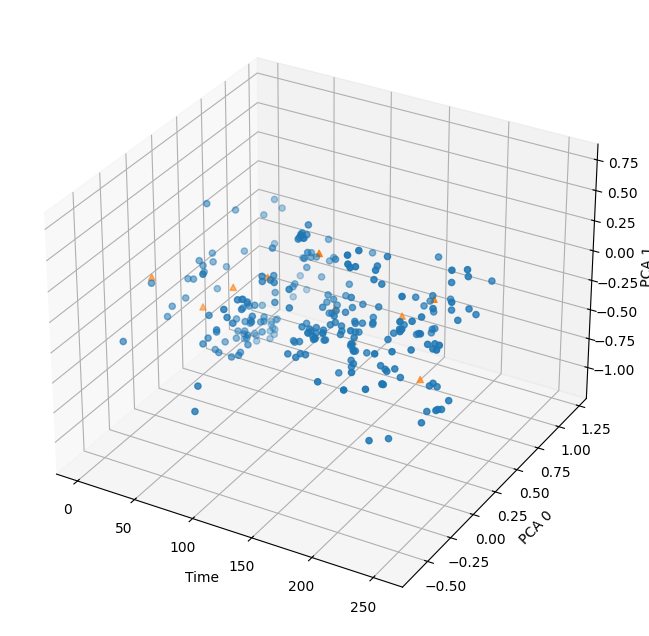

In [89]:
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(projection='3d')

time = np.arange(0, vgg16_features.shape[0], 1)
center_time = np.arange(0, vgg16_features.shape[0], vgg16_features.shape[0]//10)
ax.scatter(time, vgg16_features[:, 0], vgg16_features[:, 1], marker='o')
ax.scatter(center_time[:10], centers[:, 0], centers[:, 1], marker='^')

ax.set_xlabel('Time')
ax.set_ylabel('PCA 0')
ax.set_zlabel('PCA 1')

plt.show()

As we can see, we now get much better separation using these features, even though the clustering metrics only marignally improved. To very that we indeed clustered by scenes, let us plot the frames comprising a cluster alog with the label of their place in the timeline of the episode. 

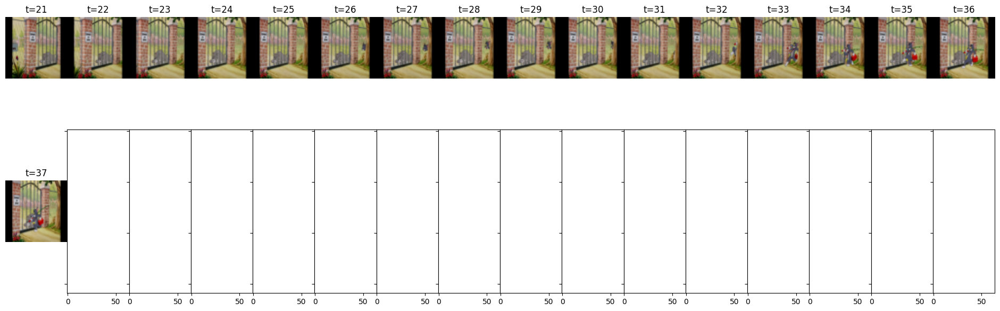

In [90]:
cluster_idx = 4
center = centers[cluster_idx]
cluster = data_kmeans == cluster_idx

cluster_labels = [f't={i}' for i in np.where(cluster)[0]]
cluster_frames = frames_tensor[cluster]

plot_frame_sequence(cluster_frames, cluster_frames.shape[0] // 16 + 1, 16, (24,8), cluster_labels)

As we can see, we successfully managed to cluster the frames by scene which suggests a complex enough network should be able to learn to do this as well the same. We can also see the difference in performance of VGG16 features compared to Shi Tomasi feature extraction method. We will compare these features to HOG and SIFT feature extraction methods as well.

### HOG & SIFT

We begin by extracting HOG and SIFT features and running cluster analysis on them. HOG, which is short for [Histogram of Oriented Gradients](https://en.wikipedia.org/wiki/Histogram_of_oriented_gradients), is a feature descriptor used in computer vision and image processing for the purpose of object detection. The technique counts occurrences of gradient orientation in localized portions of an image.

SIFT, is short for [Scale Invariant Feature Transform](https://en.wikipedia.org/wiki/Scale-invariant_feature_transform), s a computer vision algorithm to detect, describe, and match local features in images. SIFT keypoints of objects are first extracted from a set of reference images and stored in a database. An object is recognized in a new image by individually comparing each feature from the new image to this database and finding candidate matching features based on Euclidean distance of their feature vectors. From the full set of matches, subsets of keypoints that agree on the object and its location, scale, and orientation in the new image are identified to filter out good matches
Because HOG tends to produce many features we will only be taking the first few features to be on par with the SIFT feature size.

In [9]:
sample_rate = 12
num_frames = 64

sift = cv2.SIFT_create()
hog = cv2.HOGDescriptor()

sift_features = []
hog_features = []

grey_frames = []
for i in range(0, num_frames*sample_rate, sample_rate):
    cap.set(cv2.CAP_PROP_POS_FRAMES, i)
    ret, frame = cap.read()
    if not ret: break
    frame = cv2.resize(frame, (128, 128)) 
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    kp = sift.detect(frame, None)
    kp, des = sift.compute(frame, kp)
    kp = np.stack( [k.pt for k in kp] ).flatten()
    sift_features.append(kp)
    
    hog_feat = hog.compute(frame)
    hog_features.append(hog_feat[:len(kp)])

In [41]:
min_shape = min([a.shape[0] for a in sift_features])
sift_features = np.stack([a[:min_shape] for a in sift_features])
hog_features = np.stack([a[:min_shape] for a in hog_features])

sift_features.shape, hog_features.shape

((64, 184), (64, 184))

Now that we have the feature vector, we can run the cluster analysis on them and compare the performance through the clustering metrics

In [42]:
sift_data_kmeans, sift_centers = cluster_analysis(sift_features, 10, plot=False)

intra cluster distance [269.0007 224.7568 275.3427 164.8602 230.0753 248.0058 323.4903 209.4816
 299.3746   0.    ]
inter cluster distance [310.9968 333.3818 339.3125 262.9705 271.2919 221.1598 334.39   294.0904
 416.0969 332.0828 303.9777 248.8363 238.3012 281.9956 405.6663 320.6592
 449.1223 400.5748 315.7138 339.3646 232.9976 331.9399 228.4284 418.1169
 245.6702 215.084  334.3151 416.671  379.5412 491.8716 141.2403 229.1153
 352.0031 309.9803 421.6187 247.9841 367.5744 313.6335 432.7112 297.5598
 215.9144 383.758  351.7329 494.386  417.1   ]
Dunn index 0.2458725976377825


In [55]:
hog_data_kmeans, hog_centers = cluster_analysis(hog_features, 10, plot=False)

intra cluster distance [0.0406 0.0416 0.1443 0.     0.0511 0.1356 0.1396 0.     0.1942 0.    ]
inter cluster distance [0.1534 0.2834 0.5373 0.2181 0.358  0.2124 0.4473 0.251  0.3642 0.305
 0.5201 0.1977 0.3811 0.2837 0.4286 0.2774 0.3829 0.3961 0.3091 0.2552
 0.2706 0.5007 0.3037 0.2619 0.5221 0.417  0.56   0.6565 0.5464 0.36
 0.3767 0.2634 0.4301 0.2533 0.4061 0.4004 0.5464 0.3918 0.3299 0.5076
 0.2484 0.3518 0.4705 0.584  0.3823]
Dunn index 0.38338102512913513


Some what surprisingly the HOG features managed a to be on par with VGG16, prehaps due to the limited number of features produced by them.
To verify this, we will run the cluster analysis on the VGG16 features once more, but now using the 184 most siginificant features instead of the whole vector. We will find the 184 most significant features using PCA.

In [91]:
from sklearn.decomposition import PCA

pca = PCA(n_components=184)
pca.fit(vgg16_features)
pca_vgg16_features = pca.transform(vgg16_features)
pca_vgg16_features.shape

(256, 184)

In [92]:
pca_vgg16_data_kmeans, pca_vgg16_centers = cluster_analysis(pca_vgg16_features, 10, plot=False)

intra cluster distance [2.0916 5.5349 4.4876 3.135  3.3171 5.0541 4.6545 4.4834 5.1458 4.2479]
inter cluster distance [12.0429 11.4305 14.7045 11.7381  7.8333 11.3746 11.7567 12.1841 11.5856
  5.1163 11.3168  7.1116  8.132   5.5998  7.9594  7.0381  6.8111 10.6198
  6.4762  7.0267  3.4741  6.5847  6.3753  7.0164 11.5699 11.071  10.4326
  8.5538  8.9935 10.8104  7.0858  7.2251  7.7053  7.1013  5.3527  6.8708
  7.465   7.0938  7.1728  7.4937  5.7152  7.175   7.3781  8.0472  7.1767]
Dunn index 0.25990151159717834


We see a significant decline in the metrics even using the same number of features which leads us to believe that perhaps HOG will give us better separation. Let us plot the clusters generated from the HOG and visually compare. 

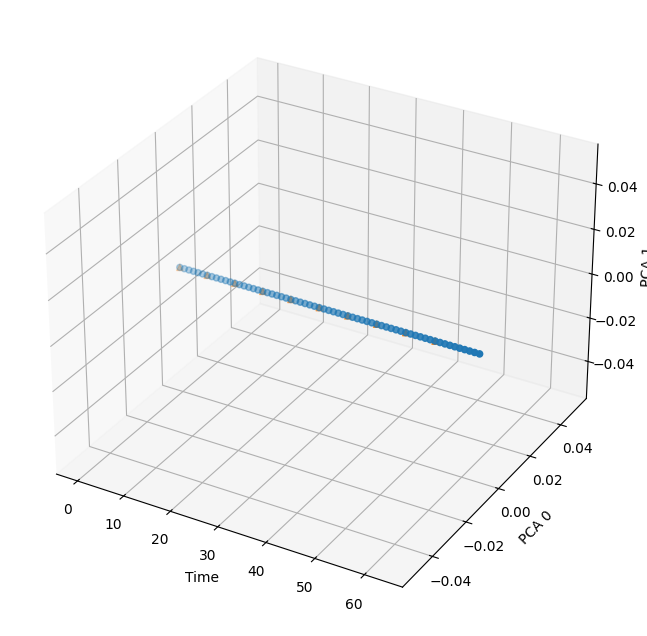

In [71]:
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(projection='3d')

time = np.arange(0, hog_features.shape[0], 1)
center_time = np.arange(0, hog_features.shape[0], hog_features.shape[0]//10)
ax.scatter(time, hog_features[:, 0], hog_features[:, 1], marker='o')
ax.scatter(center_time[:10], hog_centers[:, 0], hog_centers[:, 1], marker='^')

ax.set_xlabel('Time')
ax.set_ylabel('PCA 0')
ax.set_zlabel('PCA 1')

plt.show()

Here we can see how purely empirical analysis can sometimes mislead. It seems HOG managed such good scores by tighly grouping, almost equating distict frames, and we can see that the spread of points among the clusters is not at all seprate. This is not necessarily HOG fault, we did take only 184 out of some 34k features it produced, perhaps with some better fine tuning of the HOG parameters and some PCA we could manage better results. Lets give it a try

In [21]:
hog_features = []
num_frames = 184
for i in range(0, num_frames*sample_rate, sample_rate):
    cap.set(cv2.CAP_PROP_POS_FRAMES, i)
    ret, frame = cap.read()
    if not ret: break
    frame = cv2.resize(frame, (128, 128)) 
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    hog_feat = hog.compute(frame)
    hog_features.append(hog_feat)

max_shape = max([a.shape[0] for a in hog_features])
hog_features_new = np.zeros((len(hog_features), max_shape))
for i in range(len(hog_features)):
    vec = hog_features[i]
    for j in range(vec.shape[0]):
        hog_features_new[i, j] = vec[j]

pca = PCA(n_components=184)
pca.fit(hog_features)
pca_hog_features = pca.transform(hog_features)
pca_hog_features.shape

(184, 184)

In [22]:
pca_hog_data_kmeans, pca_hog_centers = cluster_analysis(pca_hog_features, 10, plot=False)

intra cluster distance [ 5.6372  9.2825  9.9634  8.5416  9.3268  4.7965  7.138  12.4116  6.9039
  7.4052]
inter cluster distance [19.3702 17.9248 17.6615 19.2086 22.529   8.2495 15.4194 22.1916 20.117
 13.6266 16.7798 14.7104 17.4367 18.3653 10.8777 14.2004 16.964  16.507
 15.3821 18.0415 17.0673 10.54   16.9605 16.9145 18.3441 21.3945 17.5928
 13.3729 19.4273 19.2448 18.1241 18.4058 13.0149 18.8931 10.9359 21.3192
 14.7474 19.233  19.6142 14.3349 21.3621 19.3535 14.4671 14.2117 20.266 ]
Dunn index 0.378091910611889


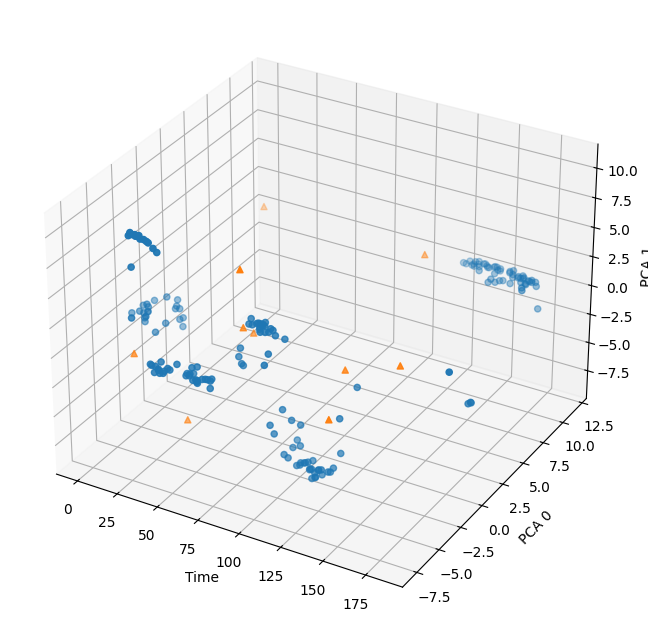

In [23]:
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(projection='3d')

time = np.arange(0, pca_hog_features.shape[0], 1)
center_time = np.arange(0, pca_hog_features.shape[0], pca_hog_features.shape[0]//10)
ax.scatter(time, pca_hog_features[:, 0], pca_hog_features[:, 1], marker='o')
ax.scatter(center_time[:10], pca_hog_centers[:, 0], pca_hog_centers[:, 1], marker='^')

ax.set_xlabel('Time')
ax.set_ylabel('PCA 0')
ax.set_zlabel('PCA 1')

plt.show()

As we can see, now that we've used the best features HOG can offer we get much better separation yet still the inter-cluster distance seems too small to represent the actual differences between the frames in the same scene but we can definately see the separation into scenes we where looking for.

## Preprocessing

After exploring our data we want to begin building our neural network and training it. but before we can do any of that we must first take the given data (an mp4 video file) and convert it to a more usable form, one that will lend itself better to training the model and tuning the hyper-parameters.

We begin by importing pytorch, the library we will be working with, as well as various other libaries for dealing with files. We will also need torchvision. 

In [3]:
# step 3
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
import torchvision.transforms as transforms
from tqdm.notebook import tqdm
import os

Next we will define some globals to be used throughout the code such as device (gpu or cpu) and various toher parameters that will take part in defining our network and therefore we must consider them when preparing the data as well. As we deduced from the EDA and from common practice, It's important to normalize the data for training therefore we will normalize to a set expectancy and deviation. We start with a relatively low latent space of just 128 floats since it's better to start small and grow by necesaity rather than start big and shrink due to the amount of time it takes to fit many parameters, we also how to keep in mind not to surpass the input dimension since that could cause severe problems when training the network as it will be unlikely to converge on good weights.

In [4]:
# step 4
VIDEO_PATH = '../data/tom_and_jerry_22_37_yt_wb.mp4'
IMAGE_DIR = '../data/tom_jerry'

if torch.cuda.is_available():
  device = torch.device('cuda:0')
else:
  device = torch.device('cpu')
print('using device',device)

image_size = (3,128,128) #shape of the input frames
latent_size = 128 #dimention of the latent space
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5) #normalization mean and std deviation

transform = transforms.Compose([
    transforms.ToPILImage(),  # Convert the tensor to a PIL Image
    transforms.Resize((64, 64)),  # Resize the image
    transforms.ToTensor(),  # Convert the PIL Image back to a tensor
    transforms.Normalize(*stats) #Normalize
])

using device cuda:0


Since we are normalizing the images we will get normalized results from the neural network, therefore we will define some functions to denomalize and visualize the outputs

In [5]:
# step 5
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

def tensor2img(tensor):
    return denorm(tensor).cpu().detach().squeeze().permute(1,2,0).numpy()

def plot_frame_sequence(sequence, rows, cols, figsize, label_seq=[]):
    seq_len = len(sequence)
    fig, ax = plt.subplots(nrows=rows, ncols=cols, sharex=True, sharey=True, figsize=figsize)
    ax = ax.flatten()
    for j in range(seq_len):
        img = tensor2img(sequence[j])
        ax[j].imshow(img)
        if j < len(label_seq): ax[j].set_title(label_seq[j])
        else: ax[j].set_title(f"t={j}")
        ax[j].axis('off')
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

Next, we must define a dataset to load the data from. The dataset is a class of pytorch used as an interface for loading samples from a given data source. Notice that our data is of massive size when fully decoded from the mp4 file and does not fit in memory, therefore we must be clever about the way we load so as not to cause data transfer bottle neck when training on the entire data set. There are many ways to tackle this problem, here I choose the approach of preprocessing the mp4 file into it's individual resized frames and storing those frames in a directory on disk, this way we sacrifice some available disk space but gain the time it would take to decode the frame which is significant since decoding some 300MB to around 2.023*10^11 is not small effort. In addition, we save both time and space be saving a resized version of the frame since for most of our algorithm we are going to use the same resolution of image. 

In [7]:
output_dir = IMAGE_DIR
os.makedirs(output_dir, exist_ok=True)

cap = cv2.VideoCapture(VIDEO_PATH)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

for frame_num in tqdm(range(total_frames)):
    ret, frame = cap.read()
    if ret:
        resized_frame = cv2.resize(frame, (image_size[1], image_size[2]))
        output_file = os.path.join(output_dir, f'{frame_num}.jpg')
        cv2.imwrite(output_file, resized_frame)
        
cap.release()

  0%|          | 0/32526 [00:00<?, ?it/s]

Now that we have our frames saved, we will write a simple dataset class to load them from the directory. Notice we took care to name them by thier index in the video, this is not coincidence and its will be vitally important later when we train the lstm, for now we use the name as an array index to know which frame to fetch next.

In [6]:
# step 6
from torchvision.io import read_image

class FrameDataset(data.Dataset):
    def __init__(self, img_dir, indices=None, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.indices = indices
        if indices is not None:
            self.num_img = len(indices)
        else:
            self.num_img = len(os.listdir(img_dir))
        
    def __len__(self):
        return self.num_img
    
    def load_image(self, idx):
        img_path = os.path.join(self.img_dir, str(idx)+'.jpg')
        image = read_image(img_path)
        if self.transform:
            image = self.transform(image)
        return image
    
    def __getitem__(self, idx):
        if self.indices is not None:
            idx = self.indices[idx]
            
        return self.load_image(idx)

frame_dataset = FrameDataset(IMAGE_DIR, transform=transform) 

rand_idx = np.random.randint(0, len(frame_dataset))
frame_dataset[rand_idx].shape, frame_dataset[rand_idx]

(torch.Size([3, 64, 64]),
 tensor([[[-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922],
          ...,
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922]],
 
         [[-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
          ...,
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
          [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000]],
 
         [[-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
  

We are now ready to define our network.

## Learning the frames
 
Recall we said we split the data into 2 tasks, learning to convert the frames inbetween a smaller intermediate linear space called the latent space, and learning the relations between the latent representation of the frames.

### The Autoencoder

An [autoencoder](https://en.wikipedia.org/wiki/Autoencoder) is a type of artificial neural network used to learn efficient codings of unlabeled data. An autoencoder learns two functions: an encoding function that transforms the input data, and a decoding function that recreates the input data from the encoded representation. The autoencoder learns an efficient representation (encoding) for a set of data, the linear space of that encoding is called the latent space, it's basically a representation of the data in space in which each feature has significant variance compared to the others, essintailly the autoencoder preforms a sort of PCA when it's learning the data.

Autoencoders have many applications such as denoising, compressing, dimentionality reduction and more but here we will use then as generators.

Mathematically, the autoencoder is defined as:
Let $X$ be the space of decoded vectors and let $Z$ be the space of encoded vectors such that both are Euclidean.
Let $m,n$ be 2 integers such that $X=\mathbb{R}^m, Z=\mathbb{R}^n$.
Let $E = \{ {\phi} | E_{\phi}:X \rightarrow Z \}$ and $D = \{ {\theta} | D_{\theta}:Z \rightarrow X \}$ be the set of encoder and decoder functions respectively, parameterized by $\phi$ and $\theta$.

Let $F_{\theta,\phi}:X \rightarrow X $ be the function defined as $F_{\theta,\phi}(x) = D_{\theta}(E_{\phi}(x))$ for any $ x \in X$. Then $F$ is an autoencoder. 
We call $Z$ the latent space.

To train the auto encoder we solve the optimize the function $ min_{\phi,\theta} \mathop{\mathbb{E}}_{x~\mu}[ F_{\theta,\phi}(x) ] $

<img src="./img/autoencoder_illustration.png" height="600" alt="Illustraion of an autoencoder"/>

### Convolutional Neural Networks

In this context we talk about convolutional neural networks with regards to [convolution](https://en.wikipedia.org/wiki/Kernel_(image_processing)) in the image processing domain. In image processing, a convolution is a mathematical operation between a kernel and an image defined as:
Let kernel $K$ be a vector of size $a \times b$ for some $a,b \in \mathbb{R}$ 
Let image $X$ be a vector of size $h \times w$ for some $h,w \in \mathbb{R}$
$Y$ is the convolution of $K$ over $X$ if $$ Y_{r,s} = \sum^{a}_{i=1}\sum^{b}_{j=1} X_{r+i-1,s+j-1}k_{i,j} $$ and $Y$ is a vector of size $(h-a+1) \times (w-b+1)$

<img src="./img/convolution_illustration.png" height="600" alt="Illustraion of a convolution"/>

In image processing, this kernels can perform many different tasks such and sharpening an image, detecting edges, blurring and more. In convolutional networks these kernels are the parameters which the network optimises over which have the amazing benefit of leanring exponential less parameters than a regular linear layer which is creatical when dealing with large vectors such as images. In training these kernels usually converge to edge detectors which then serve as meaninful features for other layers to learn.

### Convolutional Autoencoder

To begin the first task we will build an autoencoder with convolutional steps in the encoder that will gradually break up the "high" resolution input image into a very low resolution encoded image where the majority of the data is stored in many channels gained each convolution step, and a decoder with in inverse gradual steps to compose the image from the many channels in was broken up into.
We want this autoencoder to learn the best low dimension representation of our data so we will train it using mean squared error (MSE) over the original input, meaning, that for each input image x, we run in through the model to get y = decoder(encoder(x)) and then simply calculate (x-y)^2 as the error leaving us with an encoder that is able to convert a given frame to a latent space that characterizes the frame well and a decoder that knows how to reconstruct the image from it.

We use here multiple layers of convolution to give the network depth and to reduce the dimensions of the image to the bottleneck of the autoencoder.

<img src="./img/conv_ae.png" height="1200" alt="Diagram of the specified autoencoder"/>

In [7]:
# step 7
class ConvolutionalAutoencoder(nn.Module):
    def __init__(self,  latent_size):
        super(ConvolutionalAutoencoder, self).__init__()
        
        self.latent_size = latent_size
        
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),
            # out: 32 x 32 x 32
            
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            # out: 64 x 16 x 16
        
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            # out: 128 x 8 x 8
        
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            # out: 256 x 4 x 4
        
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            # out: 512 x 4 x 4
            
            nn.Conv2d(512, latent_size, kernel_size=4, stride=2, padding=1, bias=False),
             # out: 512 x 1 x 1
            nn.Sigmoid()
        )
        
        self.latent = nn.Linear(latent_size, latent_size)
        
        self.decoder = nn.Sequential(
            # in: latent_size x 1 x 1
        
            nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # out: 512 x 4 x 4
        
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            # out: 256 x 8 x 8
        
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            # out: 128 x 16 x 16
        
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # out: 64 x 32 x 32
        
            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
            # out: 3 x 64 x 64
        ).to(device)
    
    def forward(self, X):
        encoded = self.encoder(X)
        encoded_flat  = encoded.view(X.size(0), self.latent_size)
        latent = self.latent(encoded_flat)
        latent_img = latent.view(X.size(0), self.latent_size, 1, 1)
        decoded = self.decoder(latent_img)
        return decoded

Now that we have defined our model we begin training. As mentioned we use MSE in conjunction with the Adam optimization algorithm as it is known to preform well in most cases.

In [8]:
# step 8
from torch.optim.lr_scheduler import ExponentialLR

autoencoder = ConvolutionalAutoencoder(latent_size)
autoencoder = autoencoder.to(device)
 
loss_fn = nn.MSELoss()
optimizer = optim.AdamW(autoencoder.parameters(), lr=1e-3)
scheduler = ExponentialLR(optimizer, gamma=0.9)

autoencoder

ConvolutionalAutoencoder(
  (encoder): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(256, 512, 

In [9]:
num_epochs = 20
num_batches = len(frame_dataset) // batch_size
dataloader = data.DataLoader(frame_dataset, batch_size=batch_size, shuffle=True)
training_loss = torch.zeros(num_epochs)
for epoch in range(num_epochs):
    epoch_loss = 0
    i = 0
    for frame_batch in dataloader:
        frame_batch = frame_batch.to(device)
        
        pred_frame = autoencoder(frame_batch)
        loss = loss_fn(pred_frame, frame_batch)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        loss_val = loss.item()
        epoch_loss += loss_val
        i += 1  
        print('\rEpoch [{}/{}] Batch [{}/{}] Loss: {:.4f}'.format(epoch, num_epochs, i, num_batches, loss_val), end='')
    scheduler.step()
    training_loss[epoch] = epoch_loss/batch_size
    if epoch % 5 == 0 and epoch > 0:
        torch.save(autoencoder.state_dict(), '../models/conv_ae.pt')

Epoch [19/20] Batch [255/254] Loss: 0.0154

Now that we finished training, and with relatively good loss, lets plot the loss curve

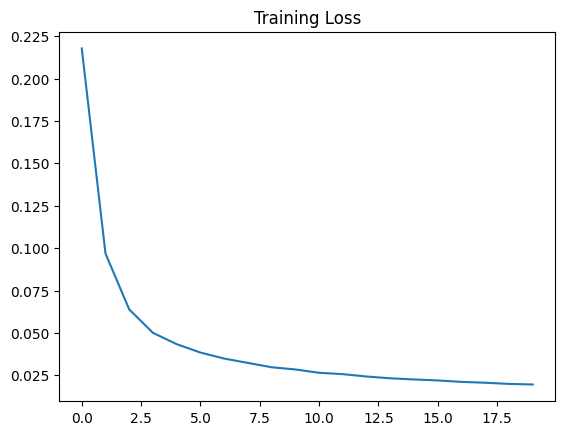

In [10]:
fig, ax = plt.subplots()
ax.plot(training_loss)
ax.set_title('Training Loss')
plt.show()

We see that the loss curve is decreasing in a fairly stable manner and plateaus out after a mere 9 epochs. This indicates to us that we may have reached the full potiential of this network for the given data set or that we may get even lower loss using a lower training rate altough we would run the risk of overfiting.
We will now run some sample frames through the network and observe it's reconstruction quality.

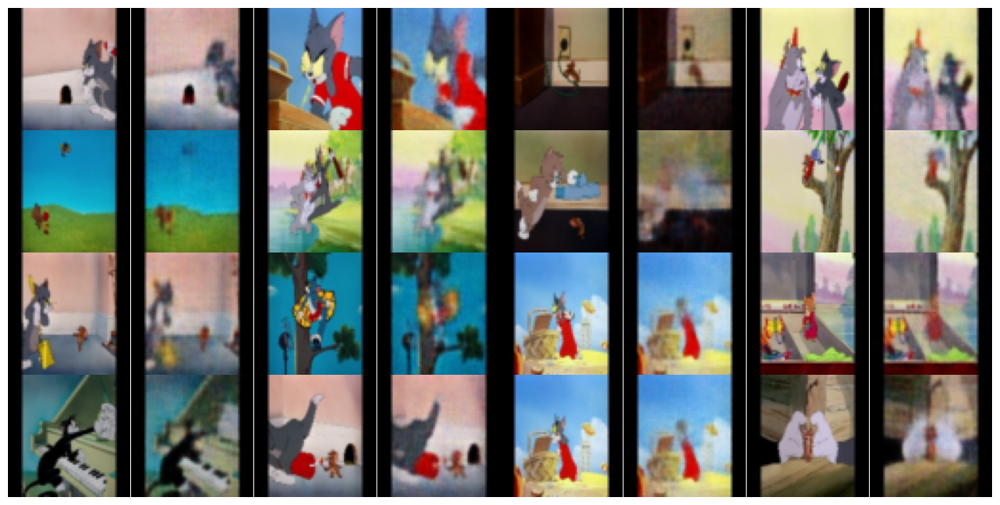

In [14]:
batch = next(iter(dataloader)).to(device)
reconstructed = autoencoder(batch)

fig, ax = plt.subplots(nrows=4, ncols=8, sharex=True, sharey=True, figsize=(16, 8))
ax = ax.flatten()
for i in range(0, 32, 2):
    img = tensor2img(batch[i])
    recon_img = tensor2img(reconstructed[i])
    ax[i].imshow(img)
    ax[i].axis('off')
    ax[i+1].imshow(recon_img)
    ax[i+1].axis('off')
    
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

Given these side by side comparisons, and considering the latent space is a mere 128 floats, we got pretty good reconstruction. It doesn't seem that more training can get any better results but rather a bigger latent space. We now move on to explore that latent space through visualization.
Note that essentially, the autoencoder is preforming a sort of PCA, i.e., finding the features with the most variance under the assumption these are the most interesting features to work on as they have the most impact on the data. So to get a feel for the shape of the latent space we will plot a few pairs of features from it's trained weights.

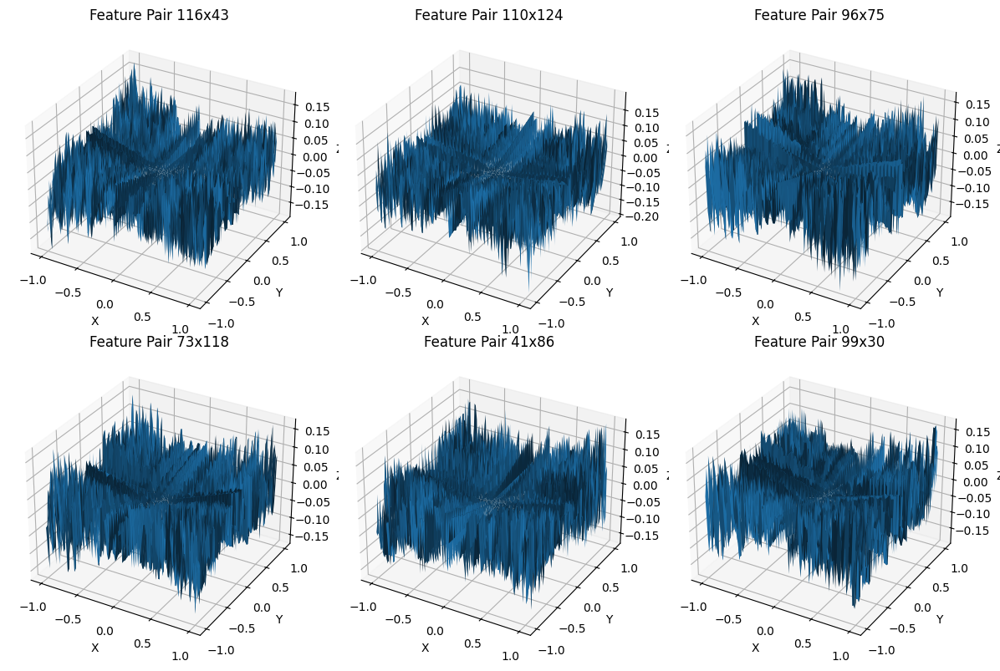

In [178]:
weights = autoencoder.latent.weight.data

feature_pairs = set()
while len(feature_pairs) < 6:
    j = torch.randint(weights.shape[0], (1,)).item()
    k = j
    while k == j:
        k = torch.randint(weights.shape[0], (1,)).item()
    feature_pairs.add((j, k))

x = torch.linspace(-1, 1, 128)
y = torch.linspace(-1, 1, 128)
X, Y = torch.meshgrid(x, y)

fig = plt.figure(figsize=(12, 8))
for i, (j,k) in enumerate(feature_pairs):
    feature1, feature2 =  weights[j], weights[k]
    ax = fig.add_subplot(2, 3, i+1, projection='3d')
    Z = feature1.reshape(1, -1) * X + feature2.reshape(-1, 1) * Y
    ax.plot_surface(X, Y, Z)
    ax.set_title(f'Feature Pair {j}x{k}')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

plt.tight_layout()
plt.show()

We can see a relatively noisey latent space but a repeating cross pattern in the middle, this suggests that the various frames of the video are encoded in the cross since most axes of the latent space converge on this cross shape.
We move on to a more experimental form of examination, we will attempt to sample the significance of various features by taking the latent vector and real frame, changing it slighlty, and comparing the result to the regular result if we were to decode the unchanged vector 

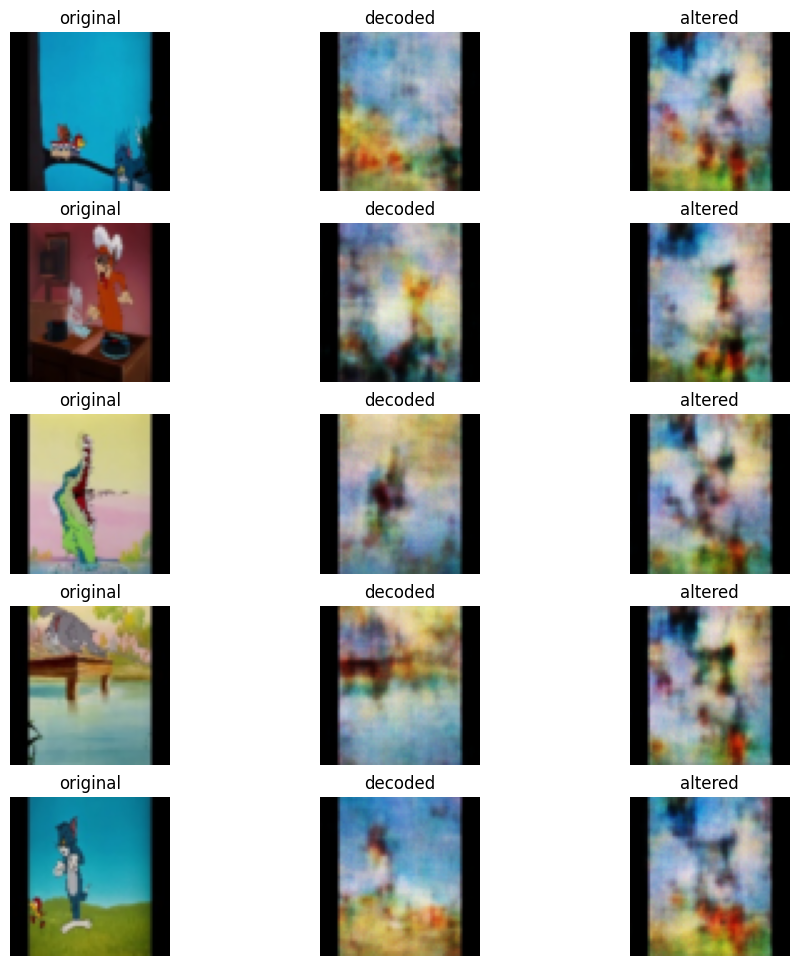

In [184]:
fig, ax = plt.subplots(nrows=5, ncols=3, sharex=True, sharey=True, figsize=(12, 12))

with torch.no_grad():
    for i in range(5):    
        rand_idx = np.random.randint(0, len(frame_dataset))
        frame = frame_dataset[rand_idx].to(device)
        
        encoded = autoencoder.encoder(frame.unsqueeze(0))
        latent = autoencoder.latent(encoded.view(1, 128))
        latent = latent.view(1, 128, 1, 1)
        
        decoded = autoencoder.decoder(latent).squeeze()
        
        altered_latent = latent.clone().detach()
        altered_latent[0] += 0.4 #alteration
        
        altered = autoencoder.decoder(altered_latent).squeeze()
            
        img = tensor2img(frame)
        decoded = tensor2img(decoded)
        altered = tensor2img(altered)
        
        ax[i,0].imshow(img)
        ax[i,0].axis('off')
        ax[i,0].set_title('original')
        
        ax[i,1].imshow(decoded)
        ax[i,1].axis('off')
        ax[i,1].set_title('decoded')
        
        ax[i,2].imshow(altered)
        ax[i,2].axis('off')
        ax[i,2].set_title('altered')
    
plt.subplots_adjust(wspace=0, hspace=0.2)
plt.show()

As we expected, due to the relatively small size of the latent space we get significant distortion to the reconstruction just by changing one latent feature, we can see among the many changes that we consistently get a white hue to the top center area of the frame compared to the regular reconstructed frame. This suggests to the role of this latent feature in the reconstruction of the frame.

Seeing as we plan on using the autoencoder to convert the frames of the video to latent vectors, we should test how well the domain of the AE is spread across the range of AE, in other words, how close the AE is to one-to-one function. To do this we will first we will plot the frames by loss value from the AE, then we will measure the amount of distinct latent vectors we get for the entire video, and finally we will plot the frames with the highest loss.

Autoencoder function spread  1.0


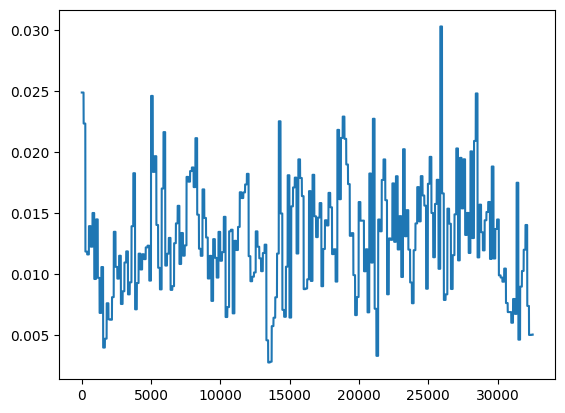

In [34]:
dataloader = data.DataLoader(frame_dataset, batch_size=batch_size, shuffle=False)
loss_values = torch.zeros(total_frames)
i = 0
for frame_batch in dataloader:
    frame_batch = frame_batch.to(device)
        
    pred_frame = autoencoder(frame_batch)
    loss = loss_fn(pred_frame, frame_batch)
    loss_val = loss.item()
    from_idx = i*batch_size
    to_idx = (i+1)*batch_size
    loss_values[from_idx:to_idx] = loss_val
    i += 1

plt.plot(loss_values)

As we can see there is variance in the loss, lets look at the frames with the highest and lowest loss to see just how significant this variance is

highest loss values tensor([0.0303, 0.0303, 0.0303, 0.0303, 0.0303, 0.0303, 0.0303, 0.0303])
lowest loss values tensor([0.0028, 0.0028, 0.0028, 0.0028, 0.0028, 0.0028, 0.0028, 0.0028, 0.0028])


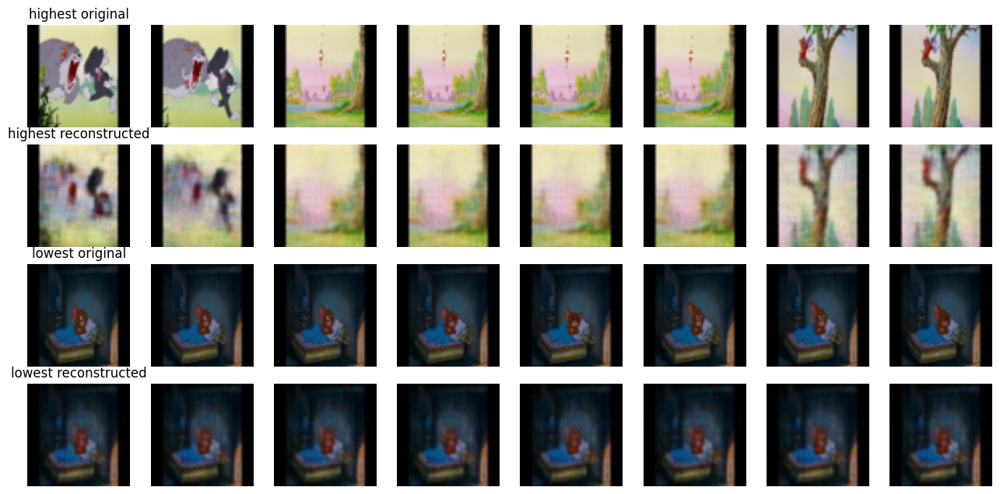

In [33]:
sorted_loss = torch.argsort(loss_values, descending=True)

max_loss = sorted_loss[:8]
min_loss = sorted_loss[total_frames-9:]

print("highest loss values", loss_values[max_loss])
print("lowest loss values", loss_values[min_loss])

max_imgs = []
for idx in max_loss:
    max_imgs.append( frame_dataset[int(idx)] )
max_imgs = torch.stack(max_imgs)

min_imgs = []
for idx in min_loss:
    min_imgs.append( frame_dataset[int(idx)] )
min_imgs = torch.stack(min_imgs)

max_recon = autoencoder(max_imgs)
min_recon = autoencoder(min_imgs)

fig, ax = plt.subplots(nrows=4, ncols=8, sharex=True, sharey=True, figsize=(16, 8))

for i in range(8):
    ax[0,i].imshow(tensor2img(max_imgs[i]))
    ax[0,i].axis('off')
    if i == 0: ax[0,i].set_title('highest original')

    ax[1,i].imshow(tensor2img(max_recon[i]))
    ax[1,i].axis('off')
    if i == 0: ax[1,i].set_title('highest reconstructed')

    ax[2,i].imshow(tensor2img(min_imgs[i]))
    ax[2,i].axis('off')
    if i == 0: ax[2,i].set_title('lowest original')

    ax[3,i].imshow(tensor2img(min_recon[i]))
    ax[3,i].axis('off')
    if i == 0: ax[3,i].set_title('lowest reconstructed')
    
plt.subplots_adjust(wspace=0.2, hspace=0)
plt.show()

although there is significant blurring, the variance in reconstruction quality is low. What's also interesting to see is that while the lowest loss frames a series of adjacent frames therefore also very similar, in the highest variance frames we see more diversity.
Let us now look at the function spread of the AE we will only look at the first 10 batch since keeping a dictionry of all the latent vectors is impossible with the amount of memory
available.

In [28]:
num_batches = 15
latent_vectors = []
i = 0
for frame_batch in dataloader:
    if i >= num_batches:
        break    
    pred_frame = autoencoder(frame_batch.to(device)).cpu()
    for frame in pred_frame:
        latent_vectors.append(frame)
    i += 1

latent_vectors = torch.stack(latent_vectors)
latent_vectors = torch.round(latent_vectors, decimals=4)
latent_vectors = torch.unique(latent_vectors, dim=0)

print(latent_vectors.shape, (num_batches*batch_size))
print("Autoencoder function spread", len(latent_vectors)/(num_batches*batch_size))

torch.Size([1918, 3, 64, 64]) 1920
Autoencoder function spread 0.9989583333333333


We see that the function spread is relatively high even when we round to the nearest 4 decimal points, this means the autoencoder does a relatively good job distinguishing between different frames even though many frames are very similar due to the nature of video. This should be taken with a grain of salt because we are only looking at around 2/32 of the total frames. This result will serve us well when training to learn to predict the next latent vector based on a series of previous ones.


## Predicting the next frame

Now that we are able to convert a frame to latent vector and vice versa, we can begin to analys the relations between frames by analysing the relation between thier latent vectors. 

### Long-Short Term Memory (LSTM) Neural Networks 

To talk about long-short term memory NNs we must first discusss recurrent NNs.
Recurrent NNs ([RNNs](https://en.wikipedia.org/wiki/Recurrent_neural_network)) are a type neural networks in which that output of one layer can be fed back into it recurrently, their main purpose to learn sequential data in which the order of the vectors in the sequences is a significant feature. This applies for example to natural language processing where the order of words define the meaning of the sentence and the order of the sentences define the meaning of the paragraph and so on.

Mathematically, a simple Elman RNN cell is defined as such:
Let input $X=\{ x_t | 0 \leq t \lt k \}$ be a sequence of $k$ vectors
Let weights $W_{hidden},W_{input}$ be a weight matrices of the cell
Let $b_{hidden},b_{input}$ be the bias vectors of the cell
Let $\sigma$ be an activation function
The hidden state of the cell is computed as 
$$ h_t(x_t) = \sigma(W_{input}x_t +  b_{input} + W_{hidden}h_{t-1} + b_{hidden}) $$
In this configuration, the hidden state of the last input vector $h_k$ can be considered as the output of the cell.

RNNs have many applications such as aforementioned natural language processing, time series prediction, machine translation, and many more. 
One big problem that RNNs have is when it comes to training on large sequences, the gradients of the internal cell parameters can quickly get out of hand and either converge to a ever smaller values or explode into really large values due to the recursive nature of the computation, this is know as the [exploding gradient (or disappearing gradient) problem](https://en.wikipedia.org/wiki/Vanishing_gradient_problem).
One solution to this problem is a type of RNN cell called the [Long Short Term Memory (LSTM)](https://en.wikipedia.org/wiki/Long_short-term_memory) cell. This cell is able to circumvent the gradients problem by "forgetting" certain pieces of data thus its parameters hold some data for a long "time" and some data gets replaced regularly. This enables LSTM the capability of learning the relationship between vectors from long sequences even if the vectors are very far apart on the sequence.

The approach here is rather simple, construct an lstm network that takes in a sequence of latent vectors and outputs the next latent vector it predicts will come after.
To do this we will need a new of dataset. Notice that autencoder is a form of unsupervised learning meaning we didn't need to label out data, we just took the same input as its own label, the task of predicting the next frame on the otherhand requires labeled data, not to mention that our input is now a sequence of frames rather than a single frame. 
We begin by extending our original dataset to produce sequences, we will start with a sequence length of roughly 0.5 seconds with is about 12 frames at 23.8 fps

In [9]:
# step 9
class FrameSequenceDataset(FrameDataset):
    def __init__(self, img_dir, seq_len=48, indices=None, transform=None):
        super().__init__(img_dir, indices, transform)
        self.seq_len = seq_len
        
    def __len__(self):
        return self.num_img - self.seq_len - 1
    
    def __getitem__(self, idx):
        if self.indices is not None:
            idx = self.indices[idx]
        
        sequence = []
        for i in range(self.seq_len):
            sequence.append(self.load_image(idx+i))
            
        next = self.load_image(idx+self.seq_len)
        
        return torch.stack(sequence), next

sequence_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, transform=transform)
X,Y = sequence_dataset[5]
X.shape,Y.shape

(torch.Size([12, 3, 64, 64]), torch.Size([3, 64, 64]))

and to demonstrate a sample from the dataset

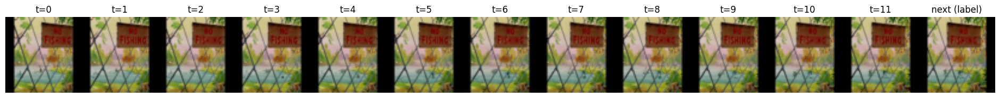

In [10]:
x, y = sequence_dataset[5]
seq_len = sequence_dataset.seq_len

label_seq = [ f"t={i}" for i in range(seq_len)]
label_seq.append('next (label)')

plot_frame_sequence(torch.cat([x, y.unsqueeze(0)]), 1, seq_len+1, (24,5), label_seq=label_seq)

Next we will define out model. In this model we are going to try extending the previous autoencoder model and simply add Long Term Short Term layers in between the latent layer and the decoder. We will still measure the loss by the difference between the decoded frames rather than the difference between the latent vectors as the latent vectors are still not a perfect representation of the frames.
<img src="./img/conv_lstm.png" height="1000" alt="Diagram of the specified convolustional lstm model"/>

In [10]:
# step 10
class ConvolutionalLSTM(ConvolutionalAutoencoder):
    def __init__(self,  latent_size, hidden_size):
        super(ConvolutionalLSTM, self).__init__(latent_size)
        
        self.hidden_size = hidden_size
        self.latent_size = latent_size
        
        self.lstm = nn.LSTM(input_size=latent_size, hidden_size=hidden_size, num_layers=3, batch_first=True)
        self.latent = nn.Linear(hidden_size, latent_size)
        
    def forward(self, X):
        output = torch.zeros(X.shape[0], self.hidden_size).to(device)
        
        for i in range(X.size(0)):
            encoded = self.encoder(X[i])
            out, (hx, cx) = self.lstm(encoded.squeeze())
            output[i] = out[-1]
            
        pred_latent = self.latent(output)
        pred_latent = pred_latent.view(pred_latent.size(0), pred_latent.size(1), 1, 1)
        decoded = self.decoder(pred_latent)
        return decoded

There are a couple of changes to the model, first we use the direct output from the encoder as a latent vector to the lstm instead of passing it through the linear layer first, this then frees up the linear layer to be updated to convert the hidden state output of the lstm to a latent vector, by making this switch we can save an additional linear layer but once we start training the network we will see if thats really the case or if the performance will get hit as a result.
We move on to training the network, we will reduce the batch size this time since 128x12x3x64x64 is a very large vector to move around all at once, we will use batch size of just 16. 
We will also separate the dataset into a training and validation with a 80%-20% split so that we can see how well the model learned the patterns in the data, we will have to be careful when splitting the data however since we are taking a sequence starting from a given index going forward sequentialy by index, there will be some overlap between training and validation which we want to avoid in order not to taint the validation set while also making sure the validation set and the traning set do not come from completely different parts of the video. To accomplish this we will split the video into 8 part and each part we will divide into a 80-20 split that way we get an 80 20 split that is much more diverse and has only 2*8 overlap points (at the end of each validation part and the end of each training part).

In [11]:
# step 11 
train_idx, valid_idx = [], []

part = total_frames // 8
eighty = int(part*0.8)
for i in range(8):
    train_idx += list(range(i*part,          i*part + eighty, 1))
    valid_idx += list(range(i*part + eighty, i*part + part, 1)  )

Now we define the new model and start training

In [13]:
# step 12
convLSTM = ConvolutionalLSTM(latent_size, 256)
convLSTM = convLSTM.to(device)

loss_fn = nn.MSELoss()
optimizer = optim.AdamW(convLSTM.parameters(), lr=1e-3)
scheduler = ExponentialLR(optimizer, gamma=0.9)

We measure the training loss at the batch level this time since 1 epoch takes a long time, we cannot afford many epochs.

In [21]:
def train_predictor(model, dataset, num_epochs, batch_size, file_path, batch_checkpoint=300):
    num_batches = len(dataset) // batch_size
    train_dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)
    model.train(True)
    
    training_loss = torch.zeros(num_epochs*num_batches+1)
    for epoch in range(num_epochs):
        epoch_loss = 0
        i = 0
        for frame_sequence, next_frame in train_dataloader:
            frame_sequence = frame_sequence.to(device).squeeze()
            next_frame = next_frame.to(device)
            
            if len(frame_sequence.shape) < 5: break
                
            pred_frame = model(frame_sequence)
            loss = loss_fn(pred_frame, next_frame)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            loss_val = loss.item()
            epoch_loss += loss_val
            
            training_loss[epoch*num_batches + i] = loss_val
            i += 1  
            print('\rEpoch [{}/{}] Batch [{}/{}] Loss: {:.4f}'.format(epoch, num_epochs, i, num_batches, loss_val), end='')
            
            if i % batch_checkpoint == 0 and i > 0: 
                scheduler.step()
                torch.save(model.state_dict(), file_path)
    torch.save(model.state_dict(), file_path)
    
    return training_loss

num_epochs = 3
batch_size = 16

train_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, indices=train_idx, transform=transform)
training_loss = train_predictor(convLSTM, train_dataset, num_epochs, batch_size, '../models/conv_lstm.pt')

Epoch [2/3] Batch [1626/1625] Loss: 0.0781

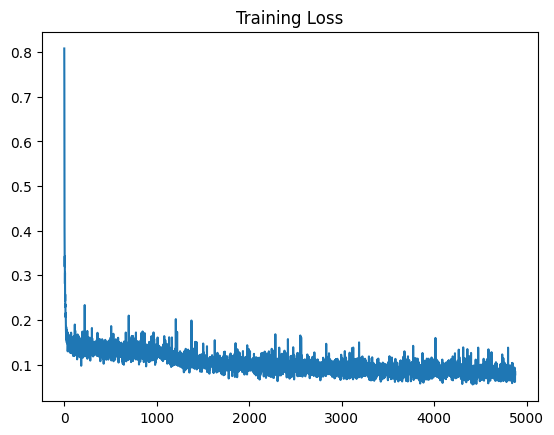

In [22]:
fig, ax = plt.subplots()
ax.plot(training_loss)
ax.set_title('Training Loss')
plt.show()

As we can see the training is painfully slow yet the computer processors are not runnning at full capacity, this is due to the sequential architecture which requires it to iterate the sequence of images one after the other rather than in parrallel. In addition to that the dataloader must spend more time fetching a sequence of images for each sample in the batch. Let's inspect the results and see if all this work was worth it, we'll show a few sequence next to their "label" frame and their predicted frame.
 

In [16]:
convLSTM.load_state_dict(torch.load('../models/conv_lstm.pt'))
convLSTM.eval()
train_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, indices=train_idx, transform=transform)

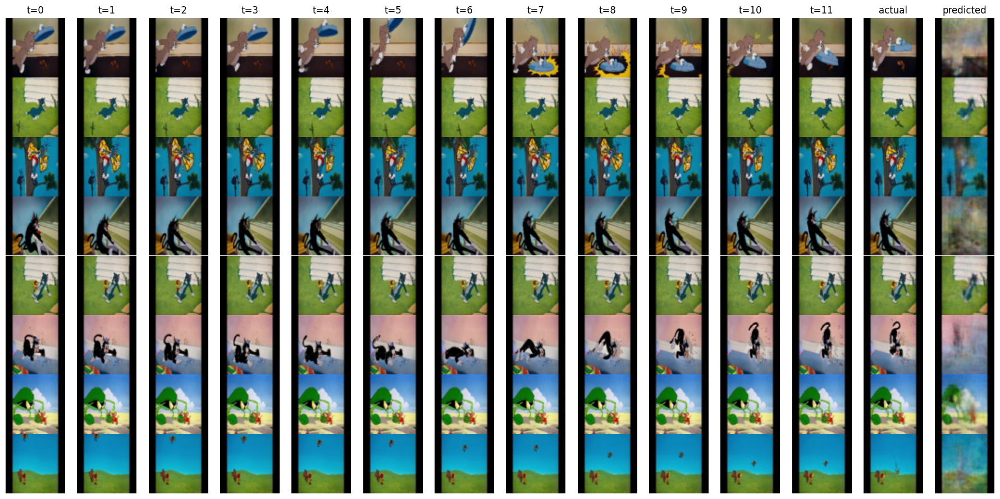

In [17]:
num_sequences = 8
seq_len = train_dataset.seq_len
random_sample_idx = torch.randint(0, len(train_dataset), (num_sequences,) )
x, y = [], []

for idx in random_sample_idx:
        sample_x, sample_y = train_dataset[ idx.item() ]
        x.append(sample_x)
        y.append(sample_y)
        
x, y = torch.stack(x).to(device), torch.stack(y).to(device)
pred_y = convLSTM(x)

label_seq = [ f"t={i}" for i in range(seq_len)]
label_seq.append('actual')
label_seq.append('predicted')

img_seq = None

for i in range(num_sequences):
    arr = [x[i], y[i].unsqueeze(0), pred_y[i].unsqueeze(0)]
    if img_seq is not None:
        arr.insert(0, img_seq)
    img_seq = torch.cat(arr)
    if i > 0:
        label_seq += [""]*(seq_len+2)

plot_frame_sequence(img_seq, num_sequences, seq_len+2, (23,11), label_seq=label_seq)

Looking at these results we can see that the network easily predicts the next frame yet the autoencoder has yet to adjust it's weights to sufficiently reconstruct the image to the quality we got out of it previously. In addition, not much cahnge happens between 2 sequential frames and even not between 2 frames which are 12 positions apart, this was already known to us though and we ran it on such a short sequence mainly to get results faster and prove the network is indeed capable of learning the data. We can see this if we try to predict the next 13 frames using a running sequence where we add the newly generated frame to the end and remove 1 from the beginning.

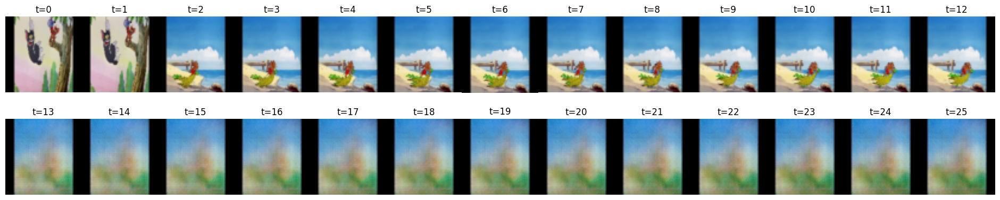

In [24]:
random_sample_idx = torch.randint(0, len(sequence_dataset), (1,) ).item()
x, y = sequence_dataset[random_sample_idx]
gen_sequence = torch.cat([x, y.unsqueeze(0)]).to(device)

for j in range(seq_len+1):
    gen_frame = convLSTM(gen_sequence[j:].unsqueeze(0))
    gen_sequence = torch.cat([gen_sequence, gen_frame])    

plot_frame_sequence(gen_sequence, 2, seq_len+1, (24,5))


As we can see, not only are the first few images very blurry, but even the subseqent frames converge onto the same frame just with increasing quality. This suggests that the autoencoder had yet to learn well the data since from the previous model we got much better results, a remedy could be to train the encoder/decoder seperately before training the entire network together or simply to use the trained encoder/decoder from the previous model.

### Improvement to Convolutional LSTM

In order for the network to be able to learn deeper and more broad patterns in the video we must increase the sequence count significantly since it must be exposed to 5 seconds of video in order to predict the next 5 and so on. This however imposes significant challenges in practice since modern hardware such as that which is available to me is not capable of loading such massive amounts of data into memory and 12 whole frames is around the sweet spot for performance, this means we have to get creative which leads us to the following thoughts:

1. We can create from the frames a new dataset of just the latent vectors and then run them all through in lstm without preforming encoding and decoding during training. The advantages of this approach is that it allows us to increase the sequence length significatly and still fit roughly into the same amount of space as 12 frames. The disadvantage is that slight errors in the latent space generated by the encoder will be thoroughly learned by the lstm can can lead it to produce exceedingly worse latent vector outputs, in other words the encoder isn't perfect and the lstm exacerbate any slight error coming from it, also we will have to build a new model containing just the lstm and then use that model in conjuction the autoencoder.
2. We can implement a skip frame mechanism, since 12 frames or even 24 frames are for most cases nearly identical, we can just treat them as one frame represented by the first frame, The advantages is again that this will also allow us to multiply our sequence length and also we can keep the model we just built as is, in addition this requires no preprocessing and minimal effort. The disadvantage is that our network will not be exposed to the relation between individual frames which means we will not be able to predict the next frame but just 12th frame after. This could be remedied by traning the network with skipped dataset as a separate model and then use it in conjuction with the current network to "fill in the gaps".
3. We could use option 1 just with a wellknown pretrained opensource image model and use the latent spaces generated by it under the assumption they are better than the ones we currently have.

We begin by trying option 2, since I am eager to see weather this network is capable of learning broader patterns in the frames after we already established it is capable of learning smaller, 1 second patterns. In addition, option 2 is simpler and quicker to implement. Let us rewrite out dataset class to accommodate skipping.

In [14]:
# step 13
class FrameSequenceDataset(FrameDataset):
    def __init__(self, img_dir, seq_len=12, indices=None, spacing=12, transform=None): # added spacing
        super().__init__(img_dir, indices, transform)
        self.seq_len = seq_len
        self.spacing = spacing # here too
        
    def __len__(self):
        return self.num_img - self.seq_len - 1
    
    def __getitem__(self, idx):
        sequence = []
        for i in range(self.seq_len):
            sequence.append(self.load_image(idx+i*self.spacing)) # modified index of image to skip by spacing
        # apply spacing to the label also, otherwise the label would be very similar to the last frame.
        next = self.load_image(idx+self.seq_len*self.spacing) 
        
        return torch.stack(sequence), next

sequence_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, spacing=12, transform=transform)
X,Y = sequence_dataset[5]
X.shape,Y.shape

(torch.Size([12, 3, 64, 64]), torch.Size([3, 64, 64]))

Now to see how much more difference we get between frames in the sequence, we sample from the dataset

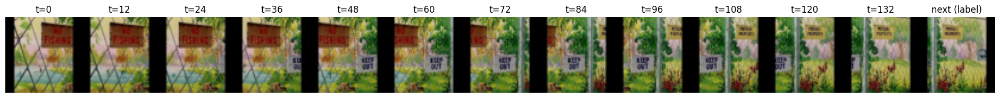

In [26]:
x, y = sequence_dataset[5]
seq_len = sequence_dataset.seq_len

label_seq = [ f"t={i*sequence_dataset.spacing}" for i in range(seq_len)]
label_seq.append('next (label)')

plot_frame_sequence(torch.cat([x, y.unsqueeze(0)]), 1, seq_len+1, (24,5), label_seq=label_seq)

As we can see, things now happen much faster in our sequence of frames and we get height variance of colors between them.
We now train our model on this new dataset to allow out network to learn these new sequences

In [18]:
num_epochs = 3
batch_size = 16
train_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, indices=train_idx, transform=transform)
training_loss = train_predictor(convLSTM, train_dataset, num_epochs, batch_size, '../models/conv_lstm_v2.pt')

Epoch [2/3] Batch [1626/1625] Loss: 0.0416

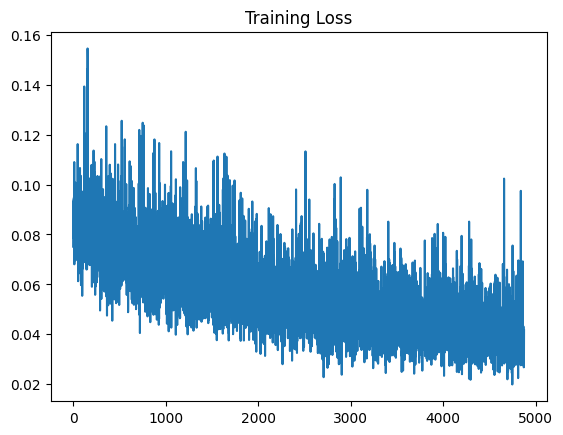

In [19]:
fig, ax = plt.subplots()
ax.plot(training_loss)
ax.set_title('Training Loss')
plt.show()

The loss values did not go down very far which is to be expected since the encoding and decoding of the frames was already learn and now we are just show the network different types of sequences. Now we inspect the results, we should see more "imagination" now out of the network since for many of the sequences the next label is radically different than the previous which will be interesting to see if it succeeds, In addition ofcourse we also inspect the ability of the network to predict the next frame as before. 

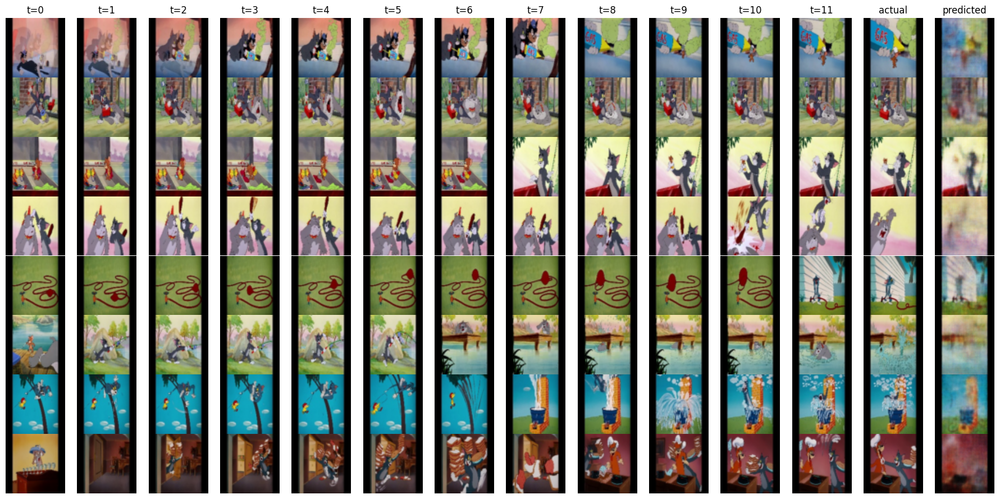

In [20]:
num_sequences = 8
seq_len = train_dataset.seq_len
random_sample_idx = torch.randint(0, len(train_dataset), (num_sequences,) )
x, y = [], []

for idx in random_sample_idx:
        sample_x, sample_y = train_dataset[ idx.item() ]
        x.append(sample_x)
        y.append(sample_y)
        
x, y = torch.stack(x).to(device), torch.stack(y).to(device)
pred_y = convLSTM(x)

label_seq = [ f"t={i}" for i in range(seq_len)]
label_seq.append('actual')
label_seq.append('predicted')

img_seq = None

for i in range(num_sequences):
    arr = [x[i], y[i].unsqueeze(0), pred_y[i].unsqueeze(0)]
    if img_seq is not None:
        arr.insert(0, img_seq)
    img_seq = torch.cat(arr)
    if i > 0:
        label_seq += [""]*(seq_len+2)

plot_frame_sequence(img_seq, num_sequences, seq_len+2, (23,11), label_seq=label_seq)

As we can see the predicted frames are more different from the actual frames which is to be expected given this network was previously trained on more similar sequences. Lets see how well it generates frames.

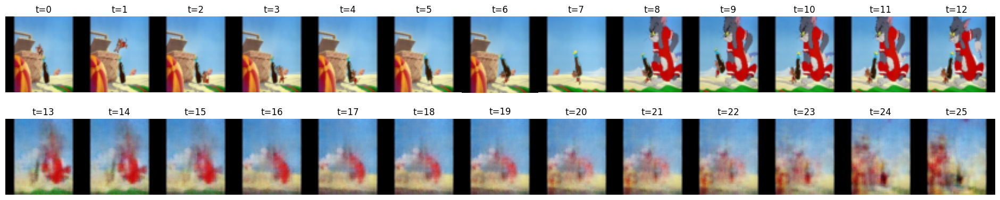

In [67]:
random_sample_idx = torch.randint(0, len(sequence_dataset), (1,) ).item()
x, y = sequence_dataset[random_sample_idx]
gen_sequence = torch.cat([x, y.unsqueeze(0)]).to(device)

for j in range(seq_len+1):
    gen_frame = convLSTM(gen_sequence[j:].unsqueeze(0))
    gen_sequence = torch.cat([gen_sequence, gen_frame])    

plot_frame_sequence(gen_sequence, 2, seq_len+1, (24,5))

We can see that there is still significant blurring in the image but what we also see it that the image now does not converge into the same frame every step but rather changes to a new "scene" gradually which is a rather exiting result. Seeing as we want to see more "creativity" meaning we want to be able to generate longer sequences without looping or converging on the same frames we should train our lstm on longer sequences, in addition we want to increase the clarity of the image since now it's barely visible what exactly is happening in the scene, to do this in we obviously need to train a better encoder and decoder (E/D) but it seems that in conjuction with the lstm the E/D are having a much more difficult time find good values to converge on even though we know they are capable of very good clarity, this leads us to try and train the lstm not on only longer sequences but on the smaller subset of the frames so that the E/D will have an easier time converging.

Epoch [2/3] Batch [1012/1011] Loss: 0.0218

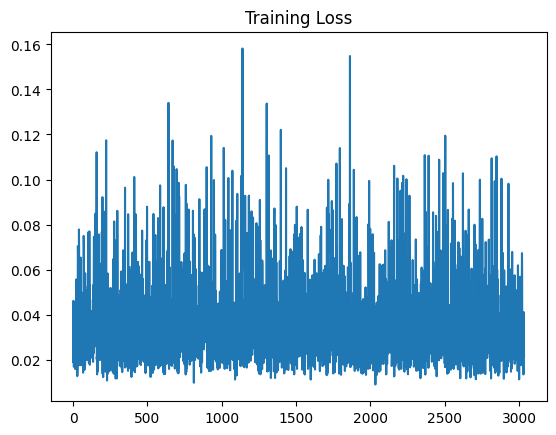

In [22]:
num_epochs = 3
batch_size = 4
train_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=48, spacing=8, indices=train_idx[:4096], transform=transform)
training_loss = train_predictor(convLSTM, train_dataset, num_epochs, batch_size, '../models/conv_lstm_v3.pt')

fig, ax = plt.subplots()
ax.plot(training_loss)
ax.set_title('Training Loss')
plt.show()

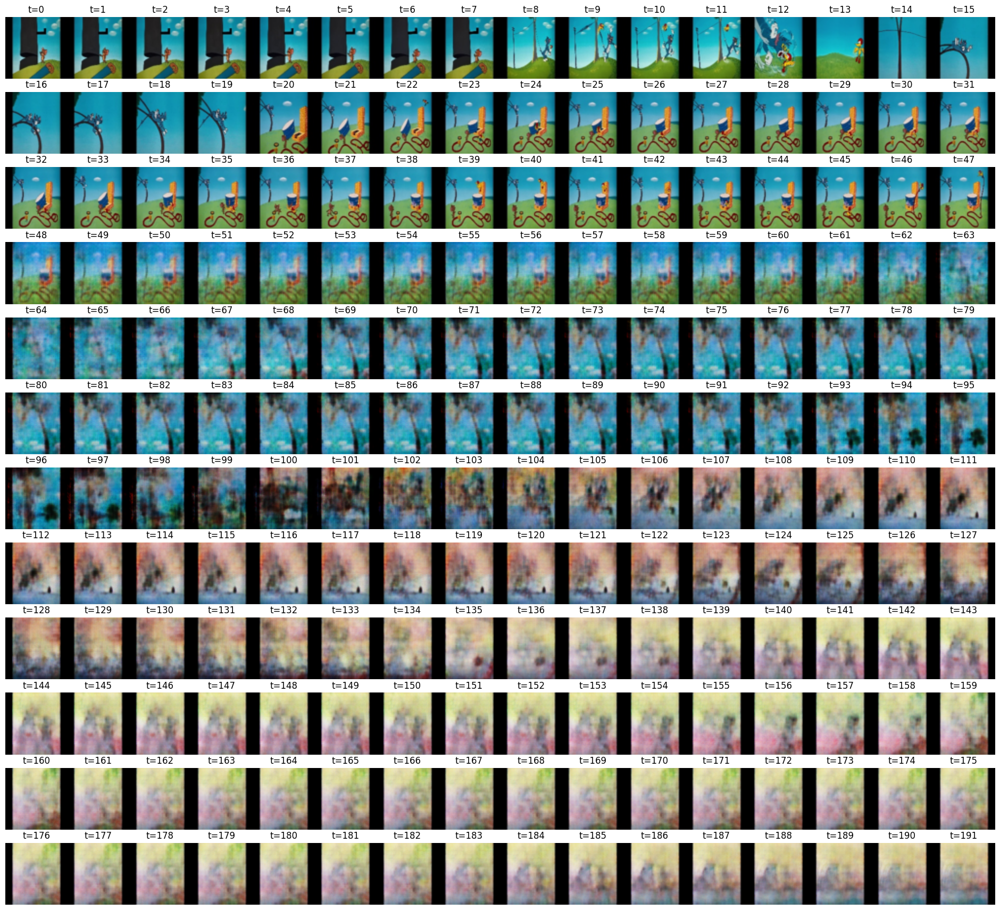

In [25]:
seq_len = 143
random_sample_idx = torch.randint(0, len(train_dataset), (1,) ).item()
gen_sequence, _ = train_dataset[random_sample_idx]
gen_sequence = gen_sequence.to(device)
for j in range(seq_len+1):
    gen_frame = convLSTM(gen_sequence[j:].unsqueeze(0))
    gen_sequence = torch.cat([gen_sequence, gen_frame])    

plot_frame_sequence(gen_sequence, 12, 16, (24,22))

We can see an improvement in the clarity of the image even though the loss values are relatively static, this is probably because the way the loss function is computed. In MSE the delta of all individual pixels gets averaged together which makes it possible for the network to achieve low loss values even if the pixels it generates are similar only on average to the input pixels, this means that an improvement in clarity will not be noticeable in the loss values generated by MSE and perhaps a better loss function would yield a clearer picture. More over we see that the network is capable of generating new scens in the show even though the clarity is not high enough to decipher exactly what is happening, which suggests the LSTM is performing well on this task as we can see a transition between scenes as the generator keeps going. It seems with much more training the network could preform much better. 

## Transfer learning

[Transfer learning](https://en.wikipedia.org/wiki/Transfer_learning) is a technique in which models trained on a certain dataset for a certain purpose is reused inconjuction with other models in order to utilize previousely learned knowledge. This technique is applicable in cases where the task for which a model was trained for is similar enough to the task at hand or can the task the model was trained for is a "sub-task" of the task at hand. Usually transfer learning involves taking a pretrained model A or part of it and traing a new model B where B is trained on the outputs of A and is then used in conjunction with A, but this is not always the case.
Here we will use another model to preform our image encoding task instead of the encoder of out autoencoder to see if higher quality features can improve performance of the model.

### DinoV2

There are many well performing pretrained neural networks made by experts that can take an image and encode them in a meaningful feature vector. One such network is [DinoV2 by Facebook](https://huggingface.co/facebook/dinov2-base), which outputs a high quality feature vector for a given image. This model is meant to serve as a base for many different image processing tasks such as classification, here however we will use it to encode the image into a feature vector and then train a convolutional network to decode the feature vector back, basically we use DinoV2 as the encoder of out LSTM autoencoder in order to see if better feature vectors can improve reconstruction quality.

We begin by downloading the model from huggingface, we use the small version of dino since we don't want to get too many features per image for now.

In [25]:
# step 14
from transformers import AutoImageProcessor, AutoModel

processor = AutoImageProcessor.from_pretrained('facebook/dinov2-small')
dinov2 = AutoModel.from_pretrained('facebook/dinov2-small')
dinov2

Dinov2Model(
  (embeddings): Dinov2Embeddings(
    (patch_embeddings): Dinov2PatchEmbeddings(
      (projection): Conv2d(3, 384, kernel_size=(14, 14), stride=(14, 14))
    )
    (dropout): Dropout(p=0.0, inplace=False)
  )
  (encoder): Dinov2Encoder(
    (layer): ModuleList(
      (0-11): 12 x Dinov2Layer(
        (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
        (attention): Dinov2Attention(
          (attention): Dinov2SelfAttention(
            (query): Linear(in_features=384, out_features=384, bias=True)
            (key): Linear(in_features=384, out_features=384, bias=True)
            (value): Linear(in_features=384, out_features=384, bias=True)
            (dropout): Dropout(p=0.0, inplace=False)
          )
          (output): Dinov2SelfOutput(
            (dense): Linear(in_features=384, out_features=384, bias=True)
            (dropout): Dropout(p=0.0, inplace=False)
          )
        )
        (layer_scale1): Dinov2LayerScale()
        (drop_path): Ide

Next, we test out what the model's I/O looks like by putting a few images through it.

In [26]:
dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, spacing=8, transform=transform)
images, _ = dataset[1024]

vectors = dinov2(images)
vectors.last_hidden_state.shape

torch.Size([12, 17, 384])

As we can see, rather than getting a flat fixed-size feature vector for each image, we get a 2d matrix of fixed feature vectors. This is due to [the way dino works internally](https://arxiv.org/pdf/2304.07193) where it cuts up the given image into subsections and produces a feature vector for each on of them.
We begin testing out the performance of this network by building a convolutional decoder. We will have to first convert the feature vectors into images that the decoder can handle, this means converting the feature vectors into square matrices but since 384 doesn't have an integer squre root with padd with zeros to get 400 features. We notice though that this increases our latent space significantly although with a meaningful features.

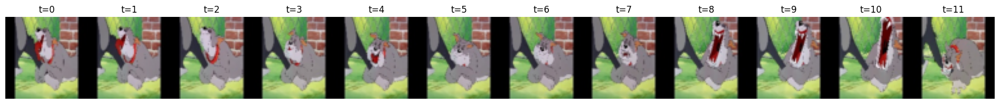

(torch.Size([12, 17, 20, 20]), None)

In [17]:
def encoded2latent(last_hidden_states):
    sqrt_features = int(np.ceil(np.sqrt(last_hidden_states.shape[2])))
    pad_amt = sqrt_features**2 - last_hidden_states.shape[2]
    latent_vectors = F.pad(input=last_hidden_states, pad=(0, pad_amt, 0, 0), mode='constant', value=0)
    latent_vectors = latent_vectors.reshape(latent_vectors.shape[0], latent_vectors.shape[1], sqrt_features, sqrt_features)
    return latent_vectors
    
latent_vectors = encoded2latent(vectors.last_hidden_state)

latent_vectors.shape, plot_frame_sequence(images, 1, 12, (24, 4))

The decoder will just consist of Inverse convolutions in the amount necesary to grow the image back to 3x64x64

In [27]:
# step 15
class Dinov2Decoder(nn.Module):
    def __init__(self,  in_channels):
        super(Dinov2Decoder, self).__init__()
        self.decoder = nn.Sequential(
            # in: 17 x 20 x 20
            nn.ConvTranspose2d(in_channels, 512, kernel_size=5, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # out: 512 x 24 x 24

            nn.ConvTranspose2d(512, 256, kernel_size=5, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            # out: 256 x 26 x 26

            nn.ConvTranspose2d(256, 128, kernel_size=5, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            # out: 128 x 28 x 28

            nn.ConvTranspose2d(128, 64, kernel_size=5, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # out: 64 x 30 x 30

            nn.ConvTranspose2d(64, 32, kernel_size=5, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(True),
            # out: 32 x 32 x 32
            
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1, bias=False),
            # out: 3 x 64 x 64 
            nn.Tanh()
        )
    
    def forward(self, X):
        latent = F.pad(input=X, pad=(0, 16, 0, 0), mode='constant', value=0)
        latent_img = latent.view(latent.shape[0], latent.shape[1], 20, 20)
        decoded = self.decoder(latent_img)
        return decoded
    
decoder = Dinov2Decoder(vectors.last_hidden_state.shape[1])
out = decoder(vectors.last_hidden_state)

In [90]:
num_epochs = 5
batch_size = 32

dataset = FrameDataset(IMAGE_DIR, transform=transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

num_batches = len(dataset) // batch_size

dinov2 = dinov2.to(device)
decoder = decoder.to(device)
loss_fn = nn.MSELoss()
optimizer = optim.AdamW(decoder.parameters(), lr=1e-3)
scheduler = ExponentialLR(optimizer, gamma=0.9)

training_loss = torch.zeros(num_epochs*num_batches+1)
decoder.train(True)
for epoch in range(num_epochs):
    epoch_loss = 0
    for i, images in enumerate(dataloader):
        images = images.to(device)
        
        encoded = dinov2(images)
        latent = encoded.last_hidden_state

        decoded = decoder(latent)
        loss = loss_fn(decoded, images)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        loss_val = loss.item()
        epoch_loss += loss_val
        
        training_loss[epoch*num_batches + i] = loss_val
        print('\rEpoch [{}/{}] Batch [{}/{}] Loss: {:.4f}'.format(epoch, num_epochs, i, num_batches, loss_val), end='')
        
        if i % (num_batches // 4) == 0 and i > 0: 
            scheduler.step()
            torch.save(decoder.state_dict(), '../models/dinov2_small_decoder.pt')
torch.save(decoder.state_dict(), '../models/dinov2_small_decoder.pt')

Epoch [4/5] Batch [1016/1016] Loss: 0.0252

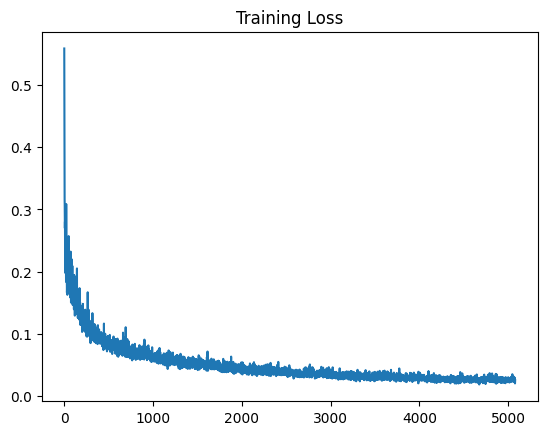

In [91]:
fig, ax = plt.subplots()
ax.plot(training_loss)
ax.set_title('Training Loss')
plt.show()

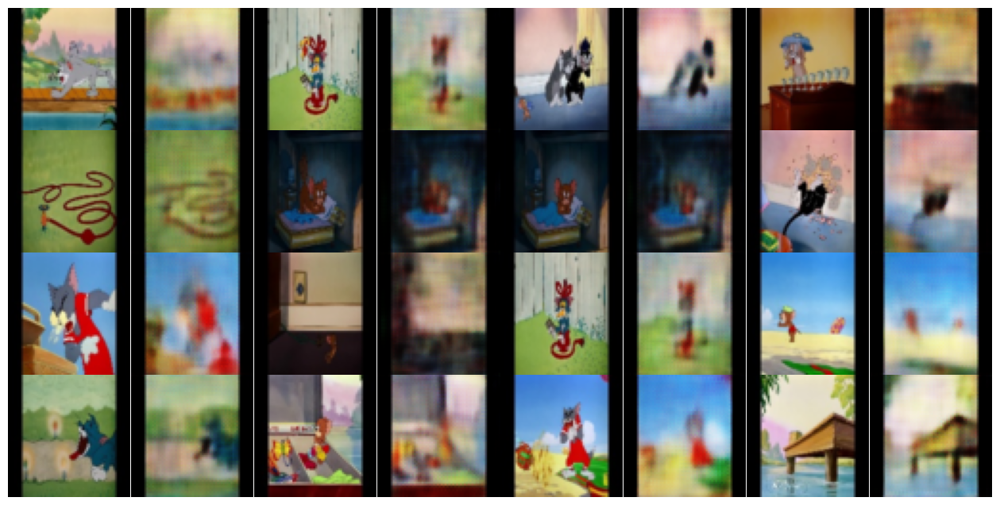

In [93]:
batch = next(iter(dataloader)).to(device)
encoded = dinov2(batch)
latent = encoded.last_hidden_state
reconstructed = decoder(latent)

fig, ax = plt.subplots(nrows=4, ncols=8, sharex=True, sharey=True, figsize=(12, 6))
ax = ax.flatten()
for i in range(0, 32, 2):
    img = tensor2img(batch[i])
    recon_img = tensor2img(reconstructed[i])
    ax[i].imshow(img)
    ax[i].axis('off')
    ax[i+1].imshow(recon_img)
    ax[i+1].axis('off')
    
plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

As we can see, the reconstruction quality has not improved significantly but the images produced do share more significant features with the originals from which they came, for example, we can see that if a character appeared in the image, he/she will also appear in the reconstructed image, something that was not always guarenteed in the previous network.
Now that we see the decoder is capable of reconstructing the image, we shall modify it to take in a sequence of images and predict the following image using with lstm layers. We can also remove the steps that padd the feature vectors with zeros since this increase in dimension can be done by the lstm.
Since DinoV2 gives us patches of the image encoded as 384 long vectors, we will concatinate all of the patches of the sequence into one long sequence of encoded image patches, and then feed those into the lstm and grab the last 17 patches to take as output vector. This means that essentially this lstm learns to predict image patches rather than full images since we are taking the last 17 rather than 1 the output will be all the same.
Show below is the diagram for the network including the external part of dino which is not actually included in the pytorch module

<img src="./img/dino_lstm.png" height="600" alt="Illustraion of an LSTM decoder for outputs od DinoV2"/>

In [28]:
# step 16
class Dinov2LSTMDecoder(Dinov2Decoder):
    def __init__(self,  in_channels):
        super(Dinov2LSTMDecoder, self).__init__(in_channels)
        self.lstm = nn.LSTM(input_size=384, hidden_size=400)
        
    def forward(self, X):
        # input: num_sequences x num_frames_per_sequence x num_patches_per_frame x feature_vector_of_patch
        last_frame_patches = (X.size(1)-1)*X.size(2)
        patches = X.view(X.size(0), X.size(1)*X.size(2), X.size(3))
        out, (hx, cx) = self.lstm(patches)
        latent_img = out.view(out.shape[0], out.shape[1], 20, 20)
        latent_img = latent_img[:, last_frame_patches:, :, :]
        decoded = self.decoder(latent_img)
        return decoded

dinoLSTM = Dinov2LSTMDecoder(17)
decoded = dinoLSTM(torch.randn(4, 12, 17, 384))
decoded.shape, dinoLSTM

(torch.Size([4, 3, 64, 64]),
 Dinov2LSTMDecoder(
   (decoder): Sequential(
     (0): ConvTranspose2d(17, 512, kernel_size=(5, 5), stride=(1, 1), bias=False)
     (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (2): ReLU(inplace=True)
     (3): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
     (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (5): ReLU(inplace=True)
     (6): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
     (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (8): ReLU(inplace=True)
     (9): ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
     (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (11): ReLU(inplace=True)
     (12): ConvTranspose2d(64, 32, kernel_size=(5, 5), stride=(1, 

Next we move on to training the network. We will ustilize what we learned from the previous network and start by training on long sequences with spacing and on a small subset of the frames. We will use only frames from the trainig set we used for the previous network.

In [106]:
torch.cuda.empty_cache()

dinov2 = dinov2.to(device)
dinoLSTM = dinoLSTM.to(device)
loss_fn = nn.MSELoss()
optimizer = optim.AdamW(dinoLSTM.parameters(), lr=1e-3)
scheduler = ExponentialLR(optimizer, gamma=0.9)

num_epochs = 3
batch_size = 8

dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=48, spacing=8, indices=train_idx[:4096], transform=transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

num_batches = len(dataset) // batch_size

training_loss = torch.zeros(num_epochs*num_batches+1)
dinoLSTM.train(True)
for epoch in range(num_epochs):
    epoch_loss = 0
    for i, (sequences, labels) in enumerate(dataloader):
        sequences = sequences.to(device)
        labels = labels.to(device)
        
        num_sequences = sequences.size(0)
        sequence_len = sequences.size(1)
        num_channels = sequences.size(2)
        frame_width = sequences.size(3)
        frame_height = sequences.size(4)
        
        sequences = sequences.view(num_sequences*sequence_len, num_channels, frame_width, frame_height)
        
        encoded = dinov2(sequences)
        latent = encoded.last_hidden_state
        latent_channels = latent.size(1)
        latent_features = latent.size(2)
        
        latent = latent.view(num_sequences, sequence_len, latent_channels, latent_features)
        
        decoded = dinoLSTM(latent)
        loss = loss_fn(decoded, labels)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        loss_val = loss.item()
        epoch_loss += loss_val
        
        training_loss[epoch*num_batches + i] = loss_val
        print('\rEpoch [{}/{}] Batch [{}/{}] Loss: {:.4f}'.format(epoch, num_epochs, i, num_batches, loss_val), end='')
        
        if i % (num_batches // 4) == 0 and i > 0: 
            scheduler.step()
            torch.save(dinoLSTM.state_dict(), '../models/dinov2_small_lstm_decoder.pt')
torch.save(dinoLSTM.state_dict(), '../models/dinov2_small_lstm_decoder.pt')

Epoch [2/3] Batch [505/505] Loss: 0.0189

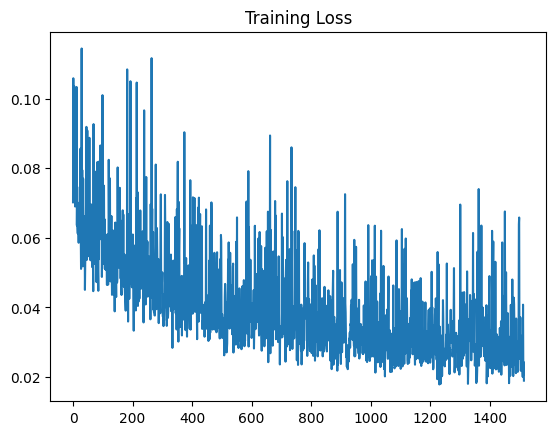

In [109]:
fig, ax = plt.subplots()
ax.plot(training_loss)
ax.set_title('Training Loss')
plt.show()

Now it's time to see how well the network predicts the correct next frame. To do this we plot a series of frame sequences and thier true next and predicted next to see how far off the network is

  0%|          | 0/8 [00:00<?, ?it/s]

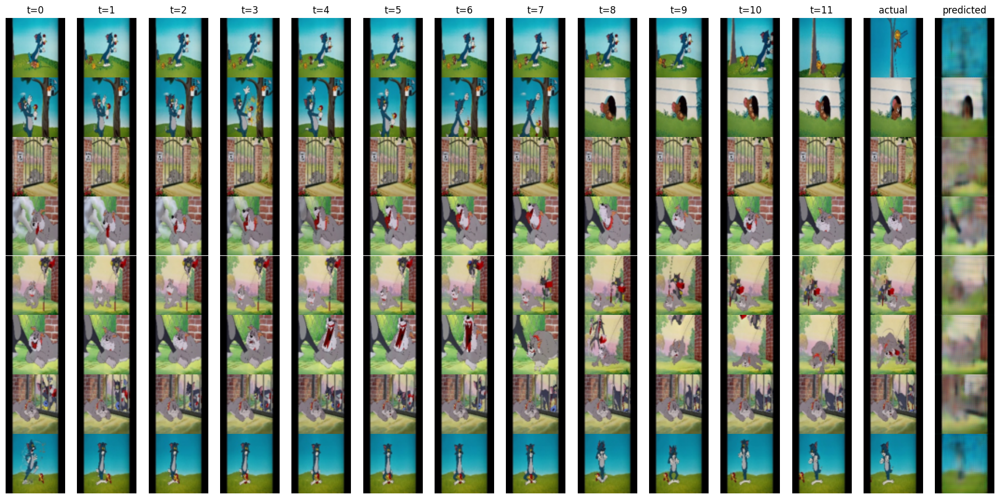

In [107]:
dataset.seq_len = 12
num_sequences = 8
seq_len = dataset.seq_len
random_sample_idx = torch.randint(0, len(dataset), (num_sequences,) )
x, y = [], []
for idx in random_sample_idx:
        sample_x, sample_y = dataset[ idx.item() ]
        x.append(sample_x)
        y.append(sample_y)
        
x, y = torch.stack(x).to(device), torch.stack(y).to(device)
x_ = x.view(num_sequences*seq_len, x.size(2), x.size(3), x.size(4))
latent = dinov2(x_)

latent = latent.last_hidden_state
latent = latent.view(num_sequences, seq_len, latent.size(1), latent.size(2))
pred_y = dinoLSTM(latent)

label_seq = [ f"t={i}" for i in range(seq_len)]
label_seq.append('actual')
label_seq.append('predicted')

img_seq = None

for i in tqdm(range(num_sequences)):
    arr = [x[i], y[i].unsqueeze(0), pred_y[i].unsqueeze(0)]
    if img_seq is not None:
        arr.insert(0, img_seq)
    img_seq = torch.cat(arr)
    if i > 0:
        label_seq += [""]*(seq_len+2)

plot_frame_sequence(img_seq, num_sequences, seq_len+2, (23,11), label_seq=label_seq)

We can see that while there is still significant blurring, we get a rather close prediction using this netowrk. Now lets see how creative it is by letting it predict the next 48 frames from a starting sequence of 24 frames.

generating [47/48]

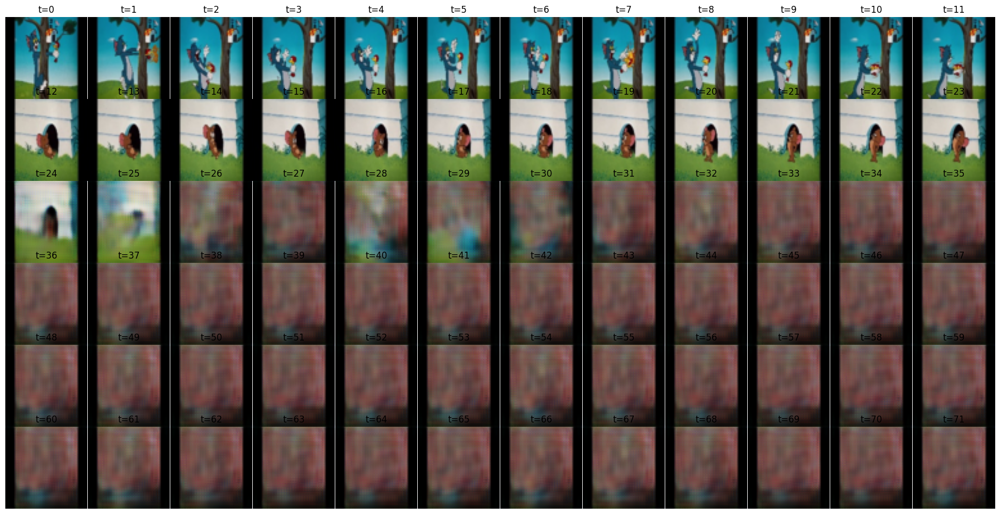

In [23]:
import gc

dataset.seq_len = 24
seq_len = 48
random_sample_idx = torch.randint(0, len(dataset), (1,) ).item()
gen_sequence, _ = dataset[random_sample_idx]

dinov2 = dinov2.to(device)
dinoLSTM = dinoLSTM.to(device)

for j in range(seq_len):    
    torch.cuda.empty_cache()
    gc.collect()
    
    latent = dinov2(gen_sequence[j:].to(device))
    latent = latent.last_hidden_state
    latent = latent.unsqueeze(0)
    gen_frame = dinoLSTM(latent)
    gen_sequence = torch.cat([gen_sequence, gen_frame.cpu()]) 
    
    del latent
    
    print('\rgenerating [{}/{}]'.format(j, seq_len), end='')

plot_frame_sequence(gen_sequence, 6, 12, (24,12))

As we can see rather disapointingly, although the network exibited promising results when it cam to predicting the next frame or reconstructing a frame, in terms of creativity its a complete failure as it quickly converges on the same frame after only 2 or 3 generated frames. There are many reason why this can happen but I suspect 2 reasons the most. One may be training, as the training method used for the previouse network may not be suited for this one and we may need to explor more training options like different sequnces lengths and dataset sizes in order to achieve good results, recall that we also train the previous model on a few fullsized datasets before using the smaller one.
Two is that the feature extracting performed by the network may be too good which causes its to quickly converge any blurry image into another blurry image, this means we must improve the decoder clarity a lot before we can see any kind of creativity from this network.  

## Finetuning

In the context of deep learning, [finetuning](https://en.wikipedia.org/wiki/Fine-tuning_(deep_learning)) commonly refers to the process of taking a model that was trained for a specific task and training it on the same task just with a specific dataset, in essence we take the weights of the model which where adjusted during the training process to perform a task on some dataset that they where trained on and making fine adjustments to those weights to perform better at the same task but for a different datasets. Finetuning is commonly done on models which where trained on a relatively general dataset for thier task to that the retraining of them for a specific dataset will really only require minimal adjustments to the weights but that is not always the case.

### VideoMAE

The [VideoMAE](https://arxiv.org/abs/2203.12602) model is a video-to-video transformer model which is was built for pre-training task. Pre-training is the first step of training large models to be used in many specific applications. In Pre-training, the model starts with an empty set of weights and an train the model on unlabeled data, this prepares it for working as a base for other tasks such as classification, regression, etc..
VideoMAE specifically was built for video tasks and it's based on the Masked Auto-Encoder architecture (hence the MAE). At the heart of VideoMAE is the [ViT](https://huggingface.co/docs/transformers/en/model_doc/vit) which is a a type of transformer that processes patches of images instead of words as a regular transformer does, it's basically an adaption of a the famouse natural language model to the computer vision realm. [Masked AE](https://arxiv.org/abs/2111.06377) are a tehnique where some of the patches of the image are omitted during trainig which increasing learning efficiency and performace.

VideoMAE takes in a tensor of 16 RGB frames in 224x224 resolution and a boolean mask, it returns a vector of patches which it predicts can accurately fill in the blanks that where omitted by the boolean mask in each frame. Therefore to make it generate complete frames we will have to ask it to predict patches for a boolean mask that omits nothing.

<img src="./img/videomae_demo.png" alt="Illustraion of a sequence of frames passing trough videomae"/>

We begin by importing the model from hugging-face and defining some helper functions

In [22]:
from transformers import AutoImageProcessor, VideoMAEForPreTraining
import numpy as np
from einops import rearrange

image_processor = AutoImageProcessor.from_pretrained("MCG-NJU/videomae-base")
model = VideoMAEForPreTraining.from_pretrained("MCG-NJU/videomae-base")

def gen_bool_mask(shape, ratio):
    num_true = int(ratio * torch.prod(torch.tensor(shape)))
    mask = torch.zeros(shape, dtype=torch.bool)
    true_indices = torch.randperm(mask.numel())[:num_true]
    mask.view(-1)[true_indices] = True
    return mask

def run_seq_through_model(seq, mask_ratio=0.7):
    #pixel_values = image_processor(list(seq), return_tensors="pt").pixel_values
    pixel_values = seq
    num_patches_per_frame = (model.config.image_size // model.config.patch_size) ** 2
    seq_length = (seq.shape[1] // model.config.tubelet_size) * num_patches_per_frame
    bool_masked_pos = gen_bool_mask((1, seq_length), mask_ratio)
    print(bool_masked_pos.shape, pixel_values.shape)

    outputs = model(pixel_values, bool_masked_pos=bool_masked_pos)
    return outputs, bool_masked_pos


def reconstruct_from_patches(orig_frames, bool_masked_pos, pred):
    patch_size = model.config.patch_size

    img_squeeze = rearrange(
        orig_frames.numpy(),
        'b (t p0) (h p1) (w p2) c -> b (t h w) (p0 p1 p2) c',
        p0=2, p1=patch_size, p2=patch_size
    )
    
    img_mean = np.mean(img_squeeze, axis=-2, keepdims=True)
    img_variance = np.var(img_squeeze, axis=-2, ddof=1, keepdims=True)
    img_norm = (img_squeeze - img_mean) / np.sqrt(img_variance)
    
    img_patch = rearrange(img_squeeze, 'b n p c -> b n (p c)')
    img_patch[bool_masked_pos] = pred
    
    mask = np.ones_like(img_patch)
    mask[bool_masked_pos] = 0
    mask = rearrange(
        mask, 'b n (p c) -> b n p c', c=3
    )
    mask = rearrange(
        mask,
        'b (t h w) (p0 p1 p2) c -> b (t p0) (h p1) (w p2) c',
        p0=2, p1=patch_size, p2=patch_size, h=14, w=14
    )
    mask.shape
    #save reconstruction video
    rec_img = rearrange(img_patch, 'b n (p c) -> b n p c', c=3)

    # Notice: To visualize the reconstruction video,
    # we add the predict and the original mean and var of each patch.
    img_mean = np.mean(img_squeeze, axis=-2, keepdims=True)
    img_std = np.sqrt(np.var(img_squeeze, axis=-2, ddof=1, keepdims=True))
    rec_img = rec_img * img_std + img_mean
    rec_img = rearrange(
        rec_img,
        'b (t h w) (p0 p1 p2) c -> b (t p0) (h p1) (w p2) c',
        p0=2, p1=patch_size, p2=patch_size, h=14, w=14
    )
    
    return rec_img

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


Since we need 224x244 images, will cannot use the existing preprocessed data. For this case, instead of preprocssing the data again we will use torchvision's VideoReader class in order to create a dataset to load our clips. We will use a sample rate of 12 for the sequences to get sufficient variance in the sequence. We will also use a low quality no sound version of the video file in order to make loading the parts of the file faster.

In [15]:
VIDEO_FILE_LOW_QUALITY = '../data/tom_jerry_silent_lowquality.mp4'

transform_videomae = transforms.Compose([
    transforms.ToPILImage(),  # Convert the tensor to a PIL Image
    transforms.Resize((224,224)),  # Resize the image
    transforms.ToTensor(),  # Convert the PIL Image back to a tensor
    transforms.Normalize(*stats)
])

class FrameSequenceDataset(Dataset):
    def __init__(self, video_path, seq_len=16, transform=None):
        self.seq_len = seq_len
        self.video = torchvision.io.VideoReader(video_path, "video")
        meta = self.video.get_metadata()
        self.fps = meta['video']['fps'][0]
        self.duration = meta['video']['duration'][0]
        self.num_frames = int(self.fps * self.duration)
        self.transform = transform

    def __len__(self):
        return self.num_frames - self.seq_len - 1

    def __getitem__(self, idx):
        frames = []
        idx_time = idx / self.fps
        i = 0
        self.video.seek(idx_time)
        for frame in self.video:
            frame = self.transform(frame['data'])
            frames.append(frame)
            i += 1
            if i >= self.seq_len: break

        return torch.stack(frames)
        
dataset = FrameSequenceDataset(VIDEO_FILE_LOW_QUALITY, transform=transform_videomae)

In order to train VideoMAE we can use the builtin loss function calculation and just call .backwards. We use a relatively small batch sinze since each sample is quite large. We use a mask ratio of around 70%, that is, 70% of the sequence patches will be omitted from each sample during training. in the paper it says that a >90% mask ration can yield good results but from small experimentation I found that 70% worked better for this dataset.

In [25]:
MODEL_FILE_PATH = '../models/videomae.pt'

model.load_state_dict(torch.load(MODEL_FILE_PATH))
model.eval()

VideoMAEForPreTraining(
  (videomae): VideoMAEModel(
    (embeddings): VideoMAEEmbeddings(
      (patch_embeddings): VideoMAEPatchEmbeddings(
        (projection): Conv3d(3, 768, kernel_size=(2, 16, 16), stride=(2, 16, 16))
      )
    )
    (encoder): VideoMAEEncoder(
      (layer): ModuleList(
        (0-11): 12 x VideoMAELayer(
          (attention): VideoMAEAttention(
            (attention): VideoMAESelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=False)
              (key): Linear(in_features=768, out_features=768, bias=False)
              (value): Linear(in_features=768, out_features=768, bias=False)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): VideoMAESelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): VideoMAEIntermediate(
            (dense): Linear(in_f

In [ ]:
optimizer = optim.AdamW(model.parameters(), lr=1e-3)

mask_ratio = 0.7
num_epochs = 30
batch_size = 32
num_batches = len(dataset) // batch_size
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

num_patches_per_frame = (model.config.image_size // model.config.patch_size) ** 2
seq_length = (dataset.seq_len // model.config.tubelet_size) * num_patches_per_frame
model = model.to(device)

training_loss = torch.zeros(num_epochs*num_batches)
for epoch in range(num_epochs):
    epoch_loss = 0
    for i, frame_seq_batch in enumerate(dataloader):
        frame_seq_batch = frame_seq_batch.to(device)
        bool_masked_pos = gen_bool_mask((1, seq_length), mask_ratio).to(device)
        bool_masked_pos = torch.cat([bool_masked_pos] * frame_seq_batch.shape[0])

        outputs = model(frame_seq_batch, bool_masked_pos=bool_masked_pos)

        optimizer.zero_grad()
        outputs.loss.backward()
        optimizer.step()

        loss_val = outputs.loss.item()
        training_loss[epoch*num_batches + i] = loss_val
        print('\rEpoch [{}/{}] Batch [{}/{}] Loss: {:.4f}'.format(epoch, num_epochs, i, num_batches, loss_val), end='')
        if i % 20 == 0:
            torch.save(model.state_dict(), MODEL_FILE_PATH)

        del frame_seq_batch, bool_masked_pos, outputs
        torch.cuda.empty_cache()
        
torch.save(model.state_dict(), MODEL_FILE_PATH)

Due to the size of the model and the batch size required to get good results this model was train on Google Colab cloud L4 clound GPU.
At the begginig of training the loss was around 0.7~ and at the end the loss was around 0.07~. Further training can bring the loss down even more as the loss has not stopped decreasing over the epochs but the for the scope of this project I will not train it further.

Next, we want to see how well the model can reconstruct a given sequence. we take a random sequence from the dataset and plot it

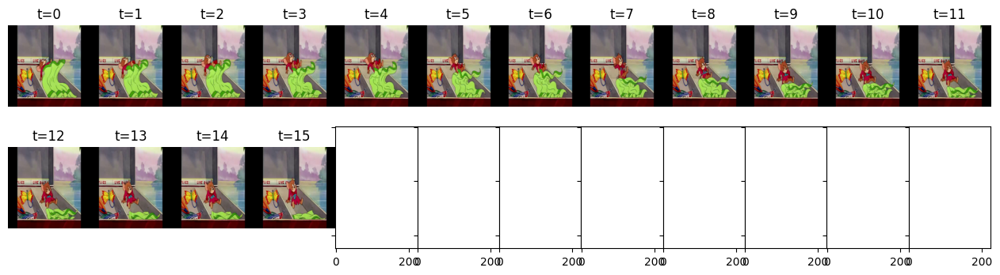

In [18]:
seq = next(iter(dataloader))[0].unsqueeze(0)
plot_frame_sequence( seq[0].permute(0, 2, 3, 1), seq[0].shape[0] // 12 + 1, 12, (16,4) )

then we run the sequence through the network, and use our helper functions to combine the resulting patches back into the image to see how well VideoMAE amanged to fill in the blanks given the amount of training it had. 

torch.Size([1, 1568]) torch.Size([1, 16, 3, 224, 224])


C:\Users\amit\AppData\Local\Temp\ipykernel_10800\1621389847.py:38: RuntimeWarning: invalid value encountered in divide
  img_norm = (img_squeeze - img_mean) / np.sqrt(img_variance)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow

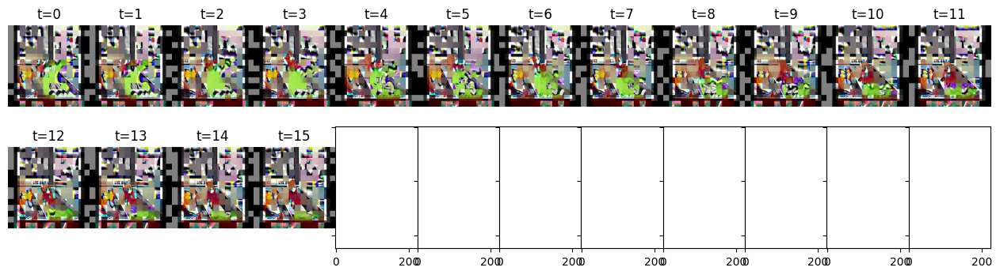

In [26]:
def pred_seq(seq):
    outputs, bool_masked_pos = run_seq_through_model(seq, 0.5)
    rec_img = reconstruct_from_patches(seq.detach().cpu().permute(0, 1, 3, 4, 2), bool_masked_pos, outputs.logits.detach().cpu())
    show_rec_img = rec_img.squeeze()
    return show_rec_img
model = model.to(device)
show_rec_img = pred_seq(seq.to(device))
plot_frame_sequence( torch.tensor(show_rec_img), show_rec_img.shape[0] // 12 + 1, 12, (16,4) )

As we can see, VideoMAE is able to predict the patches rather poorly even after extensive training, considering that half of the patches in the image are left in and half are taken from the prediction, although, the model did manage to at least color the patch in the same color as it's surrounding patches.

Next, we want to finally us the network to generate images. If we inspect the network structure we can see it's devided into 3 major components: videomae - as the encoder, encoder_to_decoder - as linear layer which bottlenecks the output from videomae, and decoder - as layer which reconstructs the patches from the output of the bottleneck layer. essentially this is an autoencoder with videomae as it's decoder, therefore, we should be able to generate patches by feeding random latent vectors directly to the decoder, or through the encoder_to_decoder layer and then to the decoder.
Because we want the network to reconstruct from it's learned memory we want to feed the smallest random latent vector we can in order to leave as much room for the decoder to affect the output.

In addition, because the network does not receive mask, it does not know how many patches to predict, and since we want full frames, we will pass into the decoder the maximum amount of patches for a sequence of frames.

C:\Users\amit\AppData\Local\Temp\ipykernel_10800\3712605189.py:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  plot_frame_sequence( torch.tensor(show_rec_img), show_rec_img.shape[0] // 12 + 1, 12, (16,4) )
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..

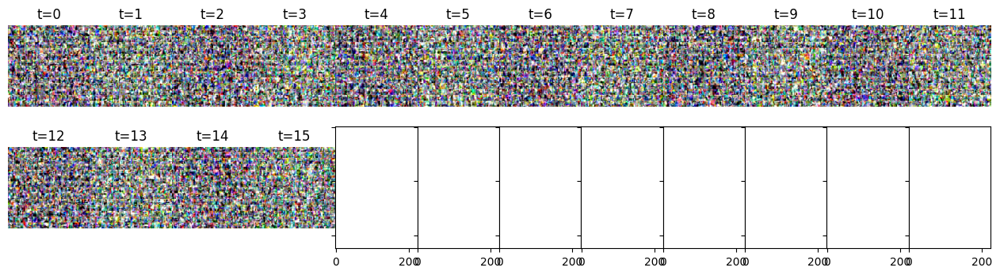

In [29]:
def reconstruct_generated_patches(pred):
    patch_size = model.config.patch_size
    img_patch = pred
    
    rec_img = rearrange(img_patch, 'b n (p c) -> b n p c', c=3)
    rec_img = rearrange(
        rec_img,
        'b (t h w) (p0 p1 p2) c -> b (t p0) (h p1) (w p2) c',
        p0=2, p1=patch_size, p2=patch_size, h=14, w=14
    )
    return rec_img

random_latent = torch.randn(1, 1568, 384).to(device) #* 0.5 + real_latent * 0.5

outputs = model.decoder(random_latent, return_token_num=1568)

rec_img = reconstruct_generated_patches(outputs.logits.detach().cpu())
show_rec_img = rec_img.squeeze()
plot_frame_sequence( torch.tensor(show_rec_img), show_rec_img.shape[0] // 12 + 1, 12, (16,4) )

Rather disappointingly we get static noise instead of anything resembeling a frame. This, together with the reconstruction results and the fact that the loss did not stabilise leads us to the conclusion that much more training is requeired in order to get the network to generate decent results.

We will try one more approaches for generating frames. 1st we will combine 50% from the latent vectors of two different sequences and generate from those latents

In [ ]:
seq1 = next(iter(dataloader))[0].unsqueeze(0)
seq2 = next(iter(dataloader))[1].unsqueeze(0)

real_latent1 = model.videomae(seq1.to(device))
real_latent1 = model.encoder_to_decoder(real_latent1.last_hidden_state)

real_latent2 = model.videomae(seq2.to(device))
real_latent2 = model.encoder_to_decoder(real_latent2.last_hidden_state)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

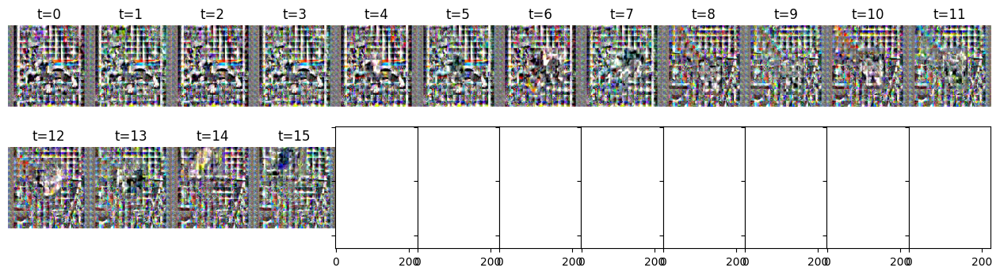

In [33]:
combined_latent = torch.cat([real_latent1[:, :784, :], real_latent2[:, 784:, :]], axis=1)

outputs = model.decoder(combined_latent, return_token_num=1568)

rec_img = reconstruct_generated_patches(outputs.logits.detach().cpu())
show_rec_img = rec_img.squeeze()
plot_frame_sequence( torch.tensor(show_rec_img), show_rec_img.shape[0] // 12 + 1, 12, (16,4) )

Here we can see some actual structure of a frame forming, which shows us that the network did manage to learn the general structure of the frame, but not sufficiently enough to form new frames from a mix of patches.

## Performance evaluation

We now move on to empirically evaluating the performance of the models we have trained to see which should empirically be the most capable. We will not include VideoMAE in the analysis as it's result's where to far below the others to merit a comparison. The main two properties we want to measure are the quality of the images produced by the model and the variety of the images produced, what we previously called "creativity". We will use a couple of established metrics which we will promptly present. 
We begin with some preparation code to make sure we have everything we need in memory. We will use the [torchmetrics](https://lightning.ai/docs/torchmetrics/stable/) library to compute some of the performance measurments.

In [17]:
convLSTM = ConvolutionalLSTM(latent_size, 256)
convLSTM.load_state_dict( torch.load('../models/conv_lstm_v3.pt') )
convLSTM.eval()
convLSTM = convLSTM.to(device)

dinoLSTM = Dinov2LSTMDecoder(17)
dinoLSTM.load_state_dict( torch.load('../models/dinov2_small_lstm_decoder.pt') )
dinoLSTM.eval()
dinoLSTM = dinoLSTM.to(device)
dinov2 = dinov2.to(device)

batch_size = 8

train_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, spacing=8, indices=train_idx, transform=transform)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

valid_dataset = FrameSequenceDataset(IMAGE_DIR, seq_len=12, spacing=8, indices=valid_idx, transform=transform)
valid_dataloader = torch.utils.data.DataLoader(valid_dataset, batch_size=batch_size, shuffle=True)

def imgSeqs2dino(sequences):
    num_sequences = sequences.size(0)
    sequence_len = sequences.size(1)
    num_channels = sequences.size(2)
    frame_width = sequences.size(3)
    frame_height = sequences.size(4)
    
    sequences = sequences.view(num_sequences*sequence_len, num_channels, frame_width, frame_height)
    
    encoded = dinov2(sequences)
    latent = encoded.last_hidden_state
    latent_channels = latent.size(1)
    latent_features = latent.size(2)
    
    latent = latent.view(num_sequences, sequence_len, latent_channels, latent_features)
    
    return latent

def plot_graphs(y1, y2, y1_label, y2_label, title, x_label, y_label, figsize=(12, 6), x=None):
    if x is None:
        x = np.linspace(0, 1, len(y1))
    
    fig, ax = plt.subplots(figsize=figsize)
    
    ax.plot(x, y1, label=y1_label)
    ax.plot(x, y2, label=y2_label)
    ax.set_title(title)
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    ax.legend()
    
    plt.show()

### Cross Validation

We begin by performing a basic measurement of cross validation to see how well our models generalize. Cross validation is defined as:

> "Learning the parameters of a prediction function and testing it on the same data is a methodological mistake: a model that would just repeat the labels of the samples that it has just seen would have a perfect score but would fail to predict anything useful on yet-unseen data" 
> &mdash; *[scikit-learn on cross-validation](https://scikit-learn.org/stable/modules/cross_validation.html)*

In other words, cross-validation requires checking the trained model on data it has not seen during training to assess how well it generalises under the assumption it would see all sorts of different data in a real use settings.
For this very reason we split our data into training and validation, we will now use the validation set to perform cross validation on the models.
To do this we will check the mean loss on the training set vs the validation set and compare the difference. 

computed batch [812/812]
computed batch [812/812]
convLSTM mean score tensor(-0.0110)
dinoLSTM mean score tensor(-0.1063)


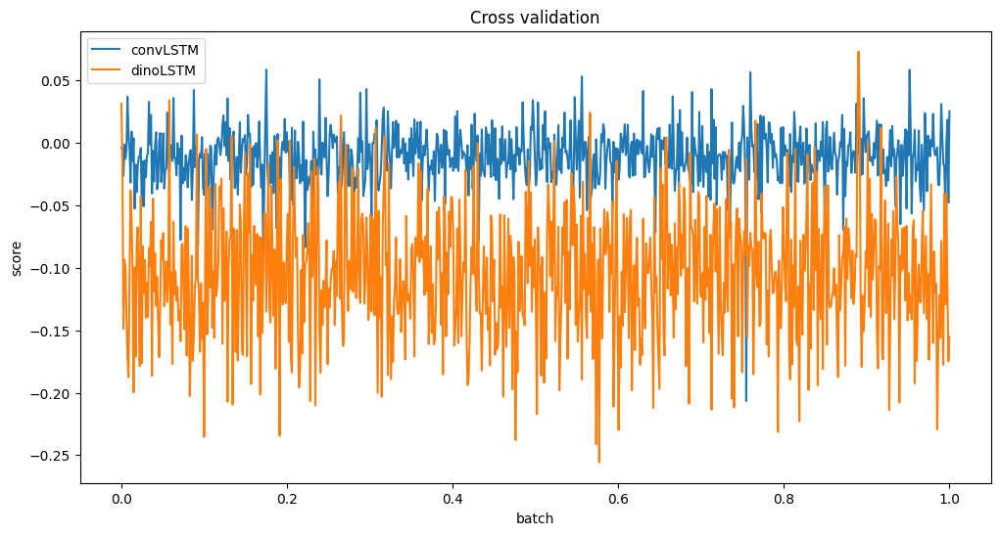

In [133]:
def cross_valid_model(model, metric, batch_pre_process=None):
    with torch.no_grad():
        iter_train = iter(train_dataloader)
        iter_valid = iter(valid_dataloader)
        
        max_batch = min( len(train_dataloader), len(valid_dataloader) )
        i = 0
        
        mean_loss_valid = torch.zeros(max_batch, requires_grad=False)
        mean_loss_train = torch.zeros(max_batch, requires_grad=False)
        
        while True:
            train_x, train_y = next(iter_train, (None,None) )
            valid_x, valid_y = next(iter_valid, (None,None) )
            
            if valid_x is None or train_x is None: break
            
            valid_x = valid_x.to(device)
            train_x = train_x.to(device)
            
            if batch_pre_process is not None:
                train_x = batch_pre_process(train_x)
                valid_x = batch_pre_process(valid_x)
            
            pred_train = model(train_x).cpu()
            pred_valid = model(valid_x).cpu()
            
            mean_loss_train[i] = metric(pred_train, train_y)
            mean_loss_valid[i] = metric(pred_valid, valid_y)
            
            i += 1
            print('\rcomputed batch [{}/{}]'.format(i, max_batch), end=('' if i < max_batch else '\n'))
        
        return (mean_loss_valid - mean_loss_train).detach()

convLSTM_cross_val = cross_valid_model(convLSTM, nn.MSELoss())
dinoLSTM_cross_val = cross_valid_model(dinoLSTM, nn.MSELoss(), imgSeqs2dino)

print('convLSTM mean score', torch.mean(convLSTM_cross_val))
print('dinoLSTM mean score', torch.mean(dinoLSTM_cross_val))

plot_graphs(convLSTM_cross_val, dinoLSTM_cross_val, 'convLSTM', 'dinoLSTM', 'Cross validation', 'batch', 'score')

We plotted this table with each row being the delta between the loss of pair of batches, one from the validation and one from training set. As we can see, both convLSTM and dinoLSTM preform rather similarly on the validation set and the training set with convLSTM performing slightly better than dinoLSTM seeing as the mean score is negative which means it's loss was smaller for validation more often than for the training.
This means the models generalize very well. 

### Accuracy

Next we measure another simple metric which is accuracy, which measure how accurately the model predicted the correct next frame from a given sequence. Formally, accuracy in machine-learning is defined as: correct predictions / total predictions.
We measure the correct/incorrect predictions of the model by counting how many sequences where predicted correctly given a certain threshold of similarity between the prediction and the actual next frame in the sequence. This allows us to the calculate the accuracy of the model

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM mean accuracy 0.06326970
dinoLSTM mean accuracy 0.03171182


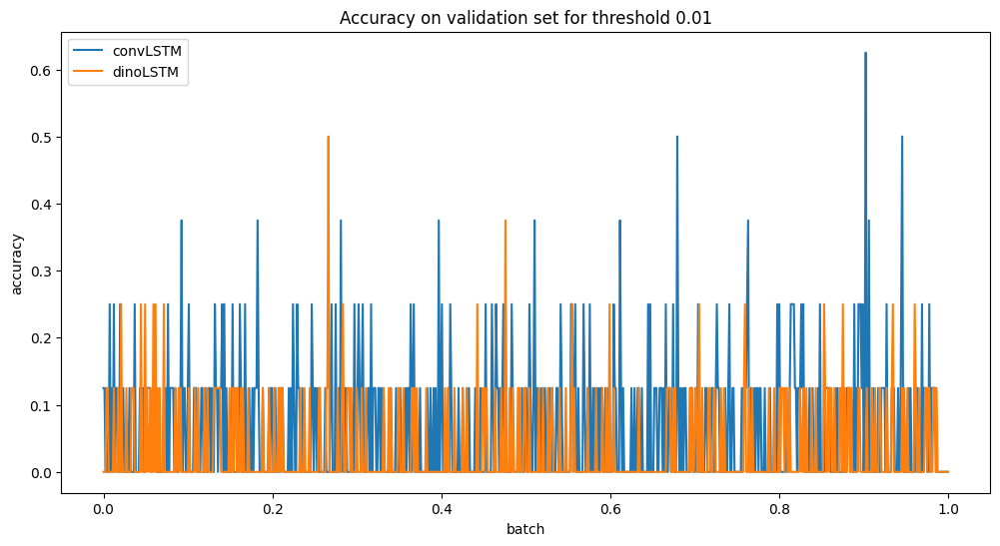

In [19]:
from torchmetrics.regression import MeanSquaredError

def accuracy_model(model, metric, threshold, batch_pre_process=None):
    with torch.no_grad():
        max_batch = len(valid_dataloader)
        accuracy = torch.zeros(max_batch, requires_grad=False)
        
        for i, (x, y) in enumerate(tqdm(valid_dataloader)):
            x = x.to(device)
            if batch_pre_process is not None:
                x = batch_pre_process(x)
            
            pred = model(x).cpu()
            
            for j in range(len(pred)):
                if metric(pred[j], y[j]) <= threshold:
                    accuracy[i] += 1
                    
            accuracy[i] /= len(pred)
        
        return accuracy

threshold = 0.01

convLSTM_accuracy = accuracy_model(convLSTM, MeanSquaredError(), threshold)
dinoLSTM_accuracy = accuracy_model(dinoLSTM, MeanSquaredError(), threshold, imgSeqs2dino)

print( 'convLSTM mean accuracy {:.8f}'.format(torch.mean(convLSTM_accuracy).item()) )
print( 'dinoLSTM mean accuracy {:.8f}'.format(torch.mean(dinoLSTM_accuracy).item()) )

plot_graphs(convLSTM_accuracy, dinoLSTM_accuracy, 'convLSTM', 'dinoLSTM', 'Accuracy on validation set for threshold '+str(threshold), 'batch', 'accuracy')

As we can see, the visual analisys we made on the generated images of both models is actually contradicted in this measurement. By measuring mean squared error between the sequences from the validation set and the predicted next frame we can see the convLSTM produces closer result to the actual next frame than dinoLSTM with convLSTM missing by alot when using a threshold value of 0.01. This could be due to difference in training.

### Learned Perceptual Image Patch Similarity (LPIPS)

The Learned Perceptual Image Patch Similarity calculates the perceptual similarity between two images [[lightning ai docs](https://lightning.ai/docs/torchmetrics/stable/image/learned_perceptual_image_patch_similarity.html)\]. 
LPIPS essentially computes the similarity between the activations of two image patches for a pre-defined network. This measure has been shown to match human perception well. A low LPIPS score means that image patches are perceptual similar.
We will use this metric to measure how similar the images our models generate are to real frames by running the models on the validation set and comparing the predicted frame to the real next frame for each sequence.

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM mean similarity 0.26226988
dinoLSTM mean similarity 0.32231274


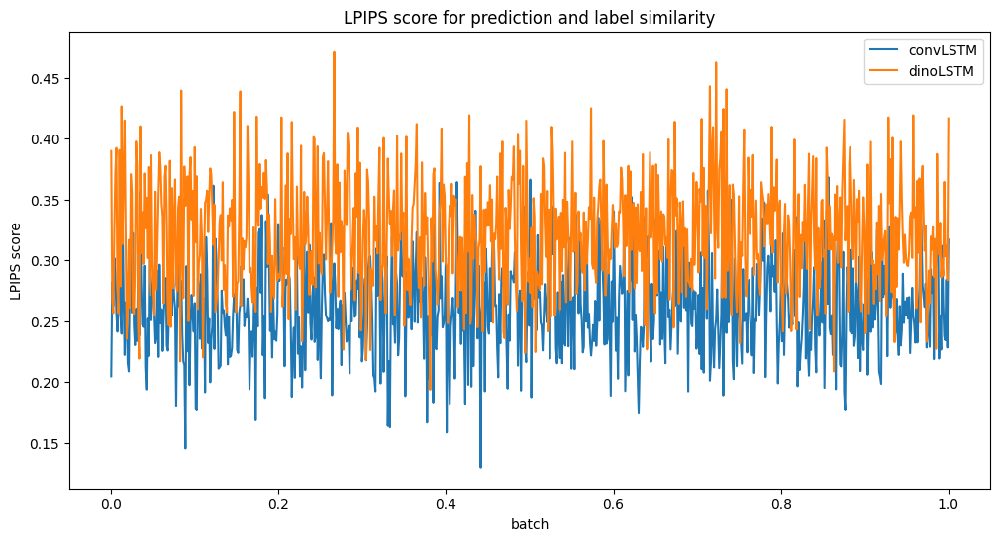

In [20]:
from torchmetrics.image.lpip import LearnedPerceptualImagePatchSimilarity

def measure_metric(model, metric, batch_pre_process=None):
    with torch.no_grad():
        max_batch = len(valid_dataloader)
        results = torch.zeros(max_batch, requires_grad=False)
        
        for i, (x, y) in enumerate(tqdm(valid_dataloader)):
            x = x.to(device)
            if batch_pre_process is not None:
                x = batch_pre_process(x)
            
            pred = model(x).cpu()
            
            results[i] = metric(pred, y)
        
        return results

lpips = LearnedPerceptualImagePatchSimilarity(net_type='squeeze')

convLSTM_similarity = measure_metric(convLSTM, lpips)
dinoLSTM_similarity = measure_metric(dinoLSTM, lpips, imgSeqs2dino)

print( 'convLSTM mean similarity {:.8f}'.format(torch.mean(convLSTM_similarity).item()) )
print( 'dinoLSTM mean similarity {:.8f}'.format(torch.mean(dinoLSTM_similarity).item()) )

plot_graphs(convLSTM_similarity, dinoLSTM_similarity, 'convLSTM', 'dinoLSTM', 'LPIPS score for prediction and label similarity', 'batch', 'LPIPS score')

What we see in this similarity based accuracy assessment is empirical evidence to the fact that convLSTM outperforms our naive autoencoder on this dataset when it comes to reconstruction, yielding images that are more visually similar to the original. This again contridicts with the visual assessment we made earlier on the results.

### Visual Information Fidelity (VIF)

The [Visual Information Fidelity](https://live.ece.utexas.edu/research/Quality/VIF.htm) is a full reference image quality assessment index based on natural scene statistics [[wikipedia](https://en.wikipedia.org/wiki/Visual_information_fidelity)\]. VIF extends the concept of fidelity to image and video quality assessment and gives a score if 0 to infinity where 0 is poorest quality, 1 in the score for a reference image, and above 1 is the score given to images that enhance the reference image. VIF in essence performs a sort of "division", modified image "divided by" reference image, and returns the ratio of the computation.
It was originally developed in the university of Texas at Austin to replace quality measured done manually by humans.

We will use VIF here to measure the quality of the images generated by our models with the original frames as reference from the validation dataset.

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM average quality 0.47652924
dinoLSTM average quality 0.51701182


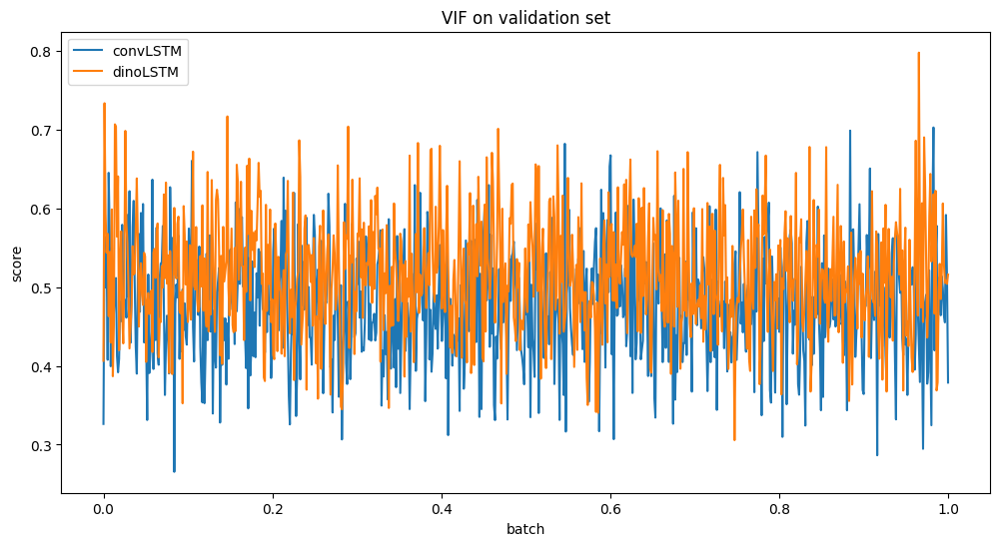

In [18]:
from torchmetrics.image import VisualInformationFidelity

vif = VisualInformationFidelity()

convLSTM_quality_vif = measure_metric(convLSTM, vif)
dinoLSTM_quality_vif = measure_metric(dinoLSTM, vif, imgSeqs2dino)

print( 'convLSTM average quality {:.8f}'.format(torch.mean(convLSTM_quality_vif).item()) )
print( 'dinoLSTM average quality {:.8f}'.format(torch.mean(dinoLSTM_quality_vif).item()) )

plot_graphs(convLSTM_quality_vif, dinoLSTM_quality_vif, 'convLSTM', 'dinoLSTM', 'VIF on validation set', 'batch', 'score')

Reflected in these results is the fact that we could not get our decoders to recostruct clear images, this problem was persistent in both models with both generating significant blurrynes. Even though, we can see that the dino based model still came out a little bit ahead which I predict is due to the fact that it preserved the structure of the image a little better taking care in the blurryness to at least include the main artifacts of the original image such as characters and objects where as in convLSTM they sometimes disappear.

### Root Mean Squared Error

[Root Mean Squared Error](https://en.wikipedia.org/wiki/Root-mean-square_deviation) is simply a root of the mean square error function and is used to measure difference between label vector and predicted vector just like in MSE. The differences is that RMSE produces a positive output and although just like it is sensitive to outliers, it measures the error in the same units as the input data.
We will use this metric to measure the similary between the predictions and the real frames from the validation set. 

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM mean similarity 0.17944737
dinoLSTM mean similarity 0.18146995


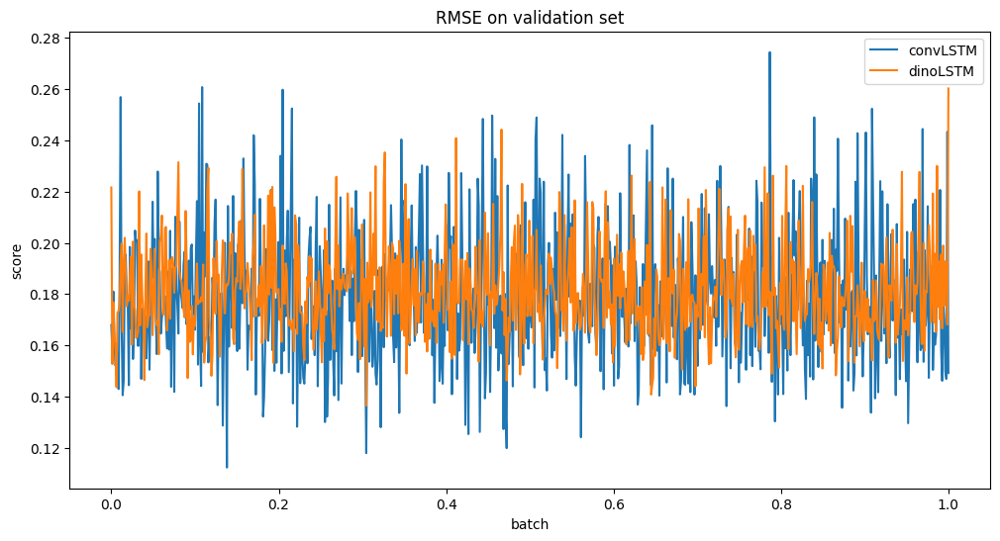

In [19]:
from torchmetrics.image import RootMeanSquaredErrorUsingSlidingWindow

rmse_sw = RootMeanSquaredErrorUsingSlidingWindow()

convLSTM_rmse_similarity = measure_metric(convLSTM, rmse_sw)
dinoLSTM_rmse_similarity = measure_metric(dinoLSTM, rmse_sw, imgSeqs2dino)

print( 'convLSTM mean similarity {:.8f}'.format(torch.mean(convLSTM_rmse_similarity).item()) )
print( 'dinoLSTM mean similarity {:.8f}'.format(torch.mean(dinoLSTM_rmse_similarity).item()) )

plot_graphs(convLSTM_rmse_similarity, dinoLSTM_rmse_similarity, 'convLSTM', 'dinoLSTM', 'RMSE on validation set', 'batch', 'score')

As before, a slight victory for the convLSTM but poor performance for both in general.

### Universal Image Quality Index

The [Universal Image Quality Index](https://ieeexplore.ieee.org/abstract/document/995823) (UIQ) is a metric used to evaluate the quality of an image by comparing it with a reference image just like VIF. UIQI works by calculates the similarity between two images based on their luminance, contrast, and structure and returns a score indicating the similarity between the images, with higher scores indicating higher quality or similarity.
We will use this metric in the same manner we used VIF

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM average quality 0.39121228
dinoLSTM average quality 0.35456204


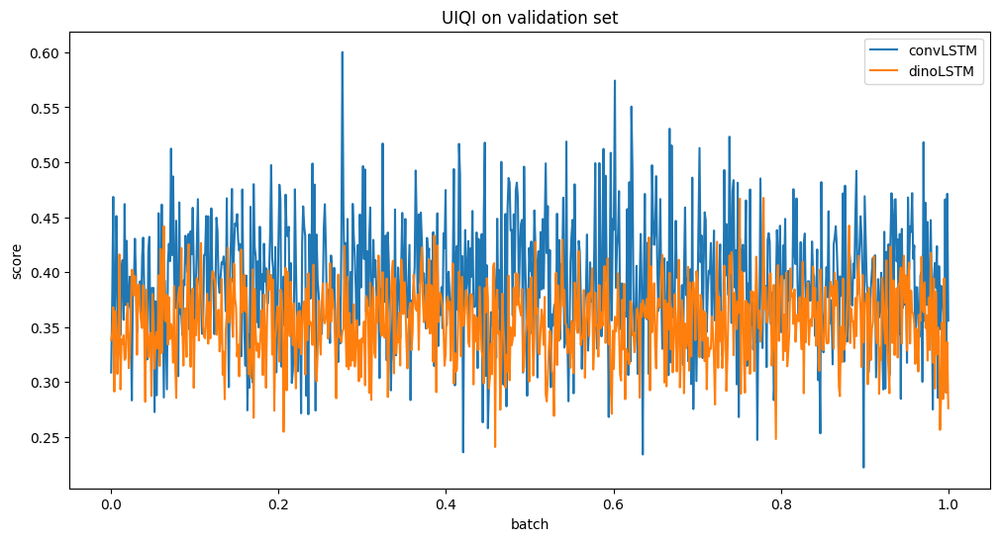

In [20]:
from torchmetrics.image import UniversalImageQualityIndex

uiq = UniversalImageQualityIndex()

convLSTM_quality_uiq = measure_metric(convLSTM, uiq)
dinoLSTM_quality_uiq = measure_metric(dinoLSTM, uiq, imgSeqs2dino)

print( 'convLSTM average quality {:.8f}'.format(torch.mean(convLSTM_quality_uiq).item()) )
print( 'dinoLSTM average quality {:.8f}'.format(torch.mean(dinoLSTM_quality_uiq).item()) )

plot_graphs(convLSTM_quality_uiq, dinoLSTM_quality_uiq, 'convLSTM', 'dinoLSTM', 'UIQI on validation set', 'batch', 'score')

This metric resolves that convLSTM outperforms dinoLSTM on the same validation set contrary to the visual assessment we made earlier, this could indicate some missing features in the images convLSTM generates that we may have missed upon visual inspection. This showcases the importance of using multiple equivalent metrics.

### Multi-Scale SSIM

 > "is a method for predicting the perceived quality of digital television and cinematic pictures, as well as other kinds of digital images and videos. It is also used for measuring the similarity between two images. The SSIM index is a full reference metric; in other words, the 
 > measurement or prediction of image quality is based on an initial uncompressed or distortion-free image as reference" &mdash; *[wikipedia](https://en.wikipedia.org/wiki/Structural_similarity_index_measure)*

The multi scale variant of SSIM is a generalizes SSIM by incorporating image details at different resolution scores.
This metric may be the most well suited to measure our models with this dataset. We will again use it to measure the quality and similarity of the generated images and the original ones.

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM average quality 0.76249945
dinoLSTM average quality 0.77569145


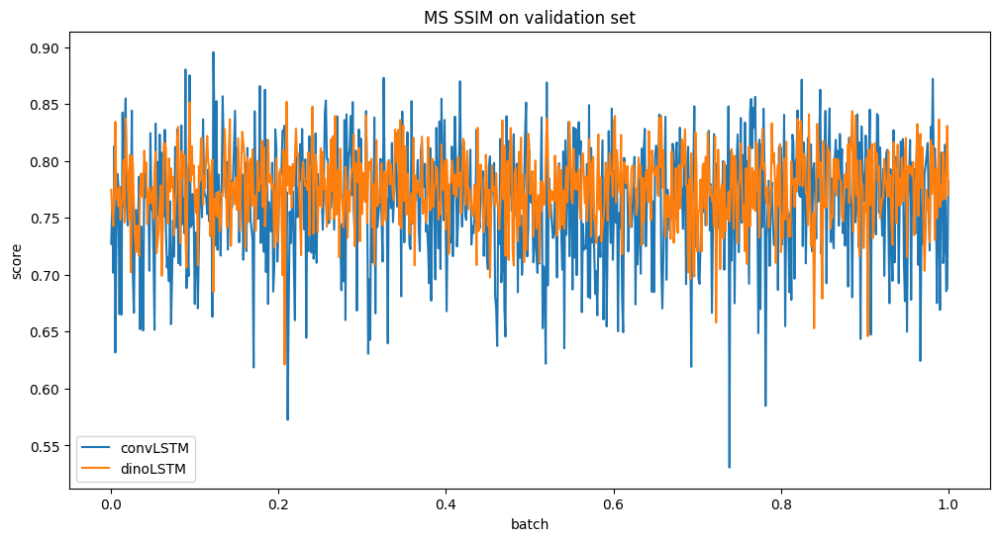

In [21]:
from torchmetrics.image import MultiScaleStructuralSimilarityIndexMeasure

ssim = MultiScaleStructuralSimilarityIndexMeasure(betas=(0.0448, 0.2856)) #use default beta values

convLSTM_quality_ssim = measure_metric(convLSTM, ssim)
dinoLSTM_quality_ssim = measure_metric(dinoLSTM, ssim, imgSeqs2dino)

print( 'convLSTM average quality {:.8f}'.format(torch.mean(convLSTM_quality_ssim).item()) )
print( 'dinoLSTM average quality {:.8f}'.format(torch.mean(dinoLSTM_quality_ssim).item()) )

plot_graphs(convLSTM_quality_ssim, dinoLSTM_quality_ssim, 'convLSTM', 'dinoLSTM', 'MS SSIM on validation set', 'batch', 'score')

Very close results but interestingly enough, with a narrow victory for the dino based model.

### Peak signal-to-noise ratio (PSNR)

> "Peak signal-to-noise ratio [(PSNR\)](https://ieeexplore.ieee.org/document/5596999) is an engineering term for the ratio between the maximum possible power of a signal and the power of corrupting noise that affects the fidelity of its representation. 
> ...PSNR is most commonly used to measure the quality of reconstruction of lossy compression codecs (e.g., for image compression). The signal in this case is the original data, and the noise is the error introduced by compression. When comparing compression codecs, PSNR is an approximation to human perception of reconstruction quality." &mdash; *[wikipedia](https://en.wikipedia.org/wiki/Peak_signal-to-noise_ratio)* 
 
We will use this metric again to measure the  quality of predictions of our models where the prediction is treated here as a reconstruction of the next frame. This will give us more insight into the quality of our models. Note that in this metric, higher value means higher quality and the values are not bounded.

  0%|          | 0/812 [00:00<?, ?it/s]

  0%|          | 0/812 [00:00<?, ?it/s]

convLSTM average quality 19.41588020
dinoLSTM average quality 19.64299393


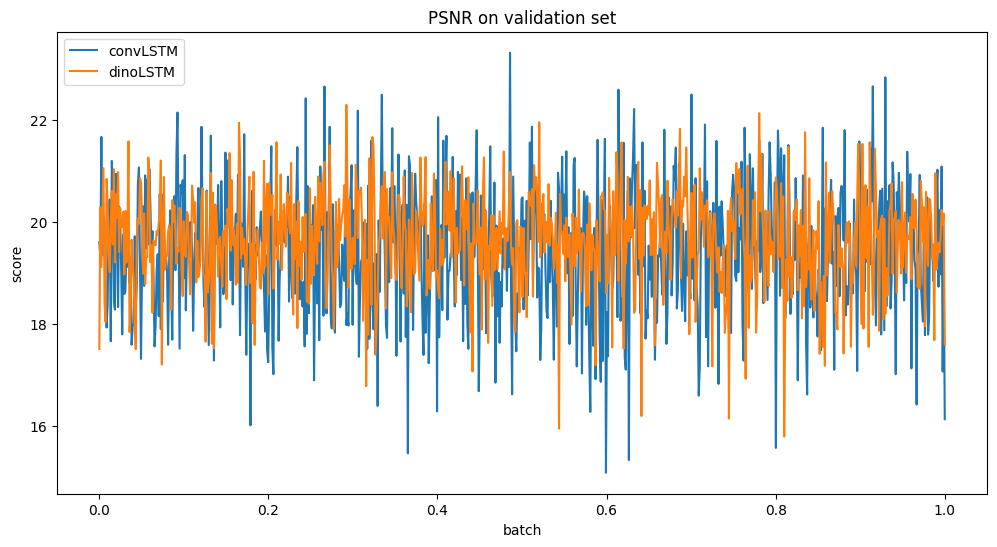

In [22]:
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio()

convLSTM_quality_psnr = measure_metric(convLSTM, psnr)
dinoLSTM_quality_psnr = measure_metric(dinoLSTM, psnr, imgSeqs2dino)

print( 'convLSTM average quality {:.8f}'.format(torch.mean(convLSTM_quality_psnr).item()) )
print( 'dinoLSTM average quality {:.8f}'.format(torch.mean(dinoLSTM_quality_psnr).item()) )

plot_graphs(convLSTM_quality_psnr, dinoLSTM_quality_psnr, 'convLSTM', 'dinoLSTM', 'PSNR on validation set', 'batch', 'score')

Again we get a narrow win for the dino based model but generally very low values for both models as the typical score should be between 30 and 50. This again empirically highlights our blurriness problem.

### Variety and creativity

After we have assesed and compared the reconstruction quality of both models we move on to assess the variety of the models. Since we are interested in generating new sequences of frames, essentially "continuing" the episode when starting from a real sequence of just "inventing" a new episode when starting from random latent vectors, we want to see that the models can both generate a varienty of frames in the sequence and that the relationship between the frames "makes sense" or in other words mimics the relation between real frames from the episode. To do this we will generate sequences and measure the similarity between the frames of the sequence and also between the similarity between frames of a real sequence. This will give us insight both into the variety the model is able to achieve and in the relation to real sequences.

We begin by assessing convLSTM and generating a sequence that begins with a real sequence as input, and then measuring the inter-sequece similarity for both using LPIP.

In [63]:
def intra_sequence_similarity(sequence, metric): # similarity between each frame and the ret of the frames
    with torch.no_grad():
        similarity = torch.zeros(seq_len)
        for i in range(0, seq_len):
            similarity[i] = metric(sequence[i].unsqueeze(0), sequence)
        similarity /= seq_len
        return similarity

def inter_frame_similarity(sequence, metric): # similarity between two neighboring frames
    with torch.no_grad():
        similarity = torch.zeros(seq_len)
        for i in range(0, seq_len-1):
            similarity[i] = metric(sequence[i].unsqueeze(0), sequence[i+1].unsqueeze(0))
        return similarity

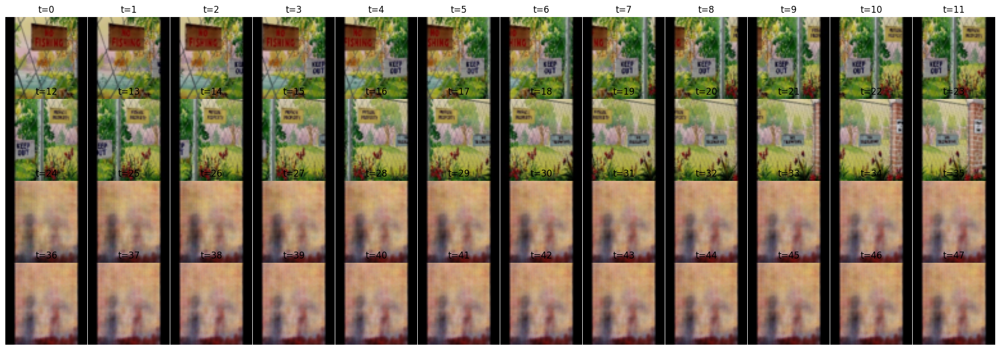

In [92]:

seq_len = 24

valid_dataset.seq_len = seq_len
random_sample_idx = torch.randint(0, len(valid_dataset), (1,) ).item()
gen_sequence, _ = valid_dataset[random_sample_idx]

for j in range(seq_len):    
    gen_frame = convLSTM(gen_sequence[j:].unsqueeze(0).to(device))
    gen_sequence = torch.cat([gen_sequence, gen_frame.cpu()]) 
    
plot_frame_sequence(gen_sequence, 4, 12, (24, 8))

generated mean similarity tensor(0.0160)
real mean similarity tensor(0.1808)
generated frames mean similarity tensor(0.0012)
real frames mean similarity tensor(0.0646)


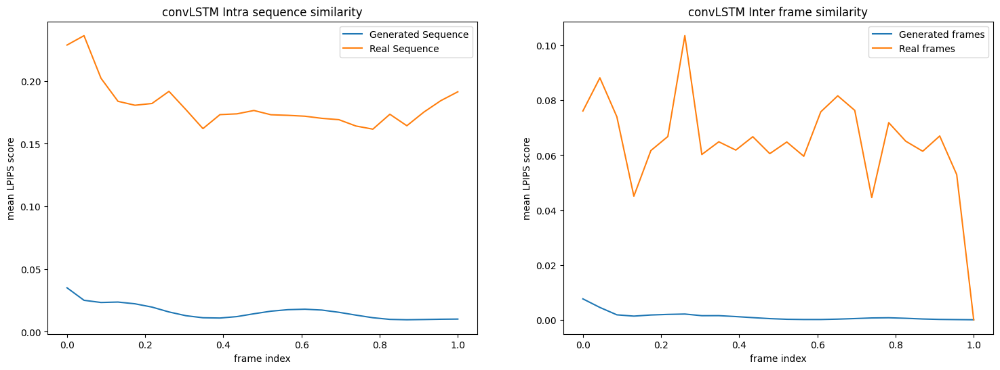

In [93]:
gen_seq_sim = intra_sequence_similarity(gen_sequence[24:], lpips)
real_seq_sim = intra_sequence_similarity(gen_sequence[:24], lpips)

print('generated mean similarity', torch.mean(gen_seq_sim))
print('real mean similarity',torch.mean(real_seq_sim))

gen_frame_sim = inter_frame_similarity(gen_sequence[24:], lpips)
real_frame_sim = inter_frame_similarity(gen_sequence[:24], lpips)

print('generated frames mean similarity', torch.mean(gen_frame_sim))
print('real frames mean similarity',torch.mean(real_frame_sim))

x = np.linspace(0, 1, 24)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

ax1.plot(x, gen_seq_sim, label='Generated Sequence')
ax1.plot(x, real_seq_sim, label='Real Sequence')
ax1.set_title('convLSTM Intra sequence similarity')
ax1.set_xlabel('frame index')
ax1.set_ylabel('mean LPIPS score')
ax1.legend()

ax2.plot(x, gen_frame_sim, label='Generated frames')
ax2.plot(x, real_frame_sim, label='Real frames')
ax2.set_title('convLSTM Inter frame similarity')
ax2.set_xlabel('frame index')
ax2.set_ylabel('mean LPIPS score')
ax2.legend()

plt.show()

As we can see, the intra sequence similarity score of the generated sequence is much lower than that of the real sequence meaning the network cannot replicate the same level of variance in the real dataset. In addition, we can see the similarity between adjacent frames is much bigger in the generated sequence which shows that the network did not learn the relationship between the frames very well. 
We move on to check the dino base model

generating [23/24]

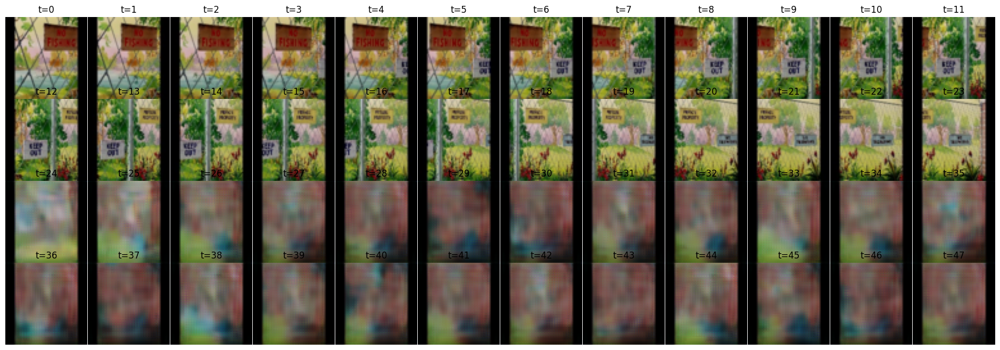

In [95]:
seq_len = 24

valid_dataset.seq_len = seq_len
random_sample_idx = torch.randint(0, len(valid_dataset), (1,) ).item()
gen_sequence, _ = valid_dataset[random_sample_idx]

dinov2 = dinov2.to(device)
dinoLSTM = dinoLSTM.to(device)

for j in range(seq_len):    
    torch.cuda.empty_cache()
    gc.collect()
    
    latent = dinov2(gen_sequence[j:].to(device))
    latent = latent.last_hidden_state
    latent = latent.unsqueeze(0)
    gen_frame = dinoLSTM(latent)
    gen_sequence = torch.cat([gen_sequence, gen_frame.cpu()]) 
    
    del latent
    
    print('\rgenerating [{}/{}]'.format(j, seq_len), end='')

plot_frame_sequence(gen_sequence, 4, 12, (24, 8))

generated mean similarity tensor(0.1038)
real mean similarity tensor(0.1903)
generated frames mean similarity tensor(0.0970)
real frames mean similarity tensor(0.0655)


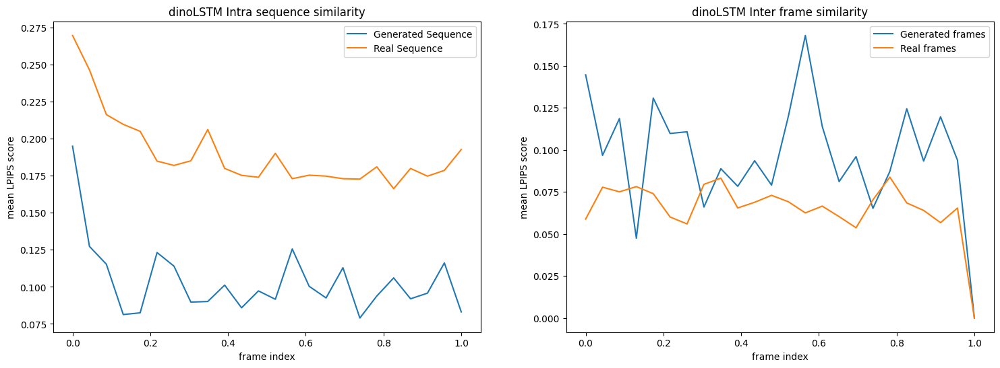

In [97]:
gen_seq_sim = intra_sequence_similarity(gen_sequence[24:], lpips)
real_seq_sim = intra_sequence_similarity(gen_sequence[:24], lpips)

print('generated mean similarity', torch.mean(gen_seq_sim))
print('real mean similarity',torch.mean(real_seq_sim))

gen_frame_sim = inter_frame_similarity(gen_sequence[24:], lpips)
real_frame_sim = inter_frame_similarity(gen_sequence[:24], lpips)

print('generated frames mean similarity', torch.mean(gen_frame_sim))
print('real frames mean similarity',torch.mean(real_frame_sim))

x = np.linspace(0, 1, 24)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

ax1.plot(x, gen_seq_sim, label='Generated Sequence')
ax1.plot(x, real_seq_sim, label='Real Sequence')
ax1.set_title('dinoLSTM Intra sequence similarity')
ax1.set_xlabel('frame index')
ax1.set_ylabel('mean LPIPS score')
ax1.legend()

ax2.plot(x, gen_frame_sim, label='Generated frames')
ax2.plot(x, real_frame_sim, label='Real frames')
ax2.set_title('dinoLSTM Inter frame similarity')
ax2.set_xlabel('frame index')
ax2.set_ylabel('mean LPIPS score')
ax2.legend()

plt.show()

Although visually the frame do not look alot more varied, the metrics are significatly better for the dino based model. We can see more creativity in both the Intra sequence and Inter frame similarity and it even has more inter-frame variance that the real sequence. A suprsing result indeed considering what we saw when we plotted the model for many more frames earlier compared to convLSTM. 
Now we will perform the same measurements but for a sequence generated from random noise.

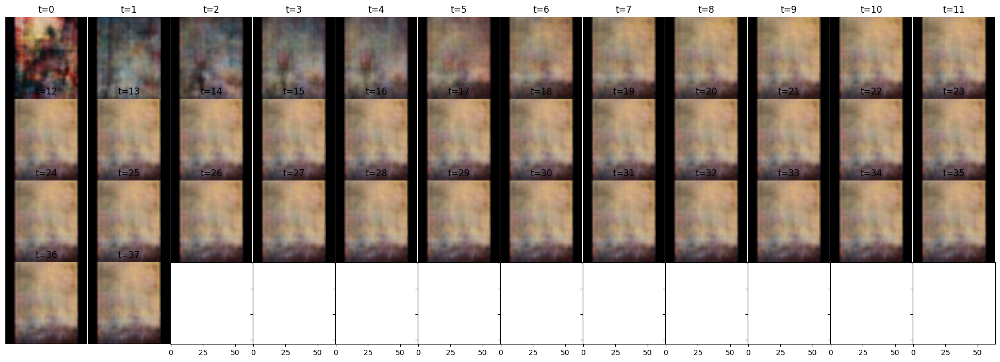

In [21]:
seq_len = 36
rand_latent = torch.randn(2, latent_size).to(device)

gen_hidden, (hx,cx) = convLSTM.lstm(rand_latent)
gen_latent = convLSTM.latent(gen_hidden)
gen_sequence = convLSTM.decoder(gen_latent.view(2, latent_size, 1, 1))

for j in range(seq_len):    
    gen_frame = convLSTM(gen_sequence[j:].unsqueeze(0))
    gen_sequence = torch.cat([gen_sequence, gen_frame]) 

gen_sequnce_convLSTM = gen_sequence

plot_frame_sequence(gen_sequnce_convLSTM, 4, 12, (24, 8))

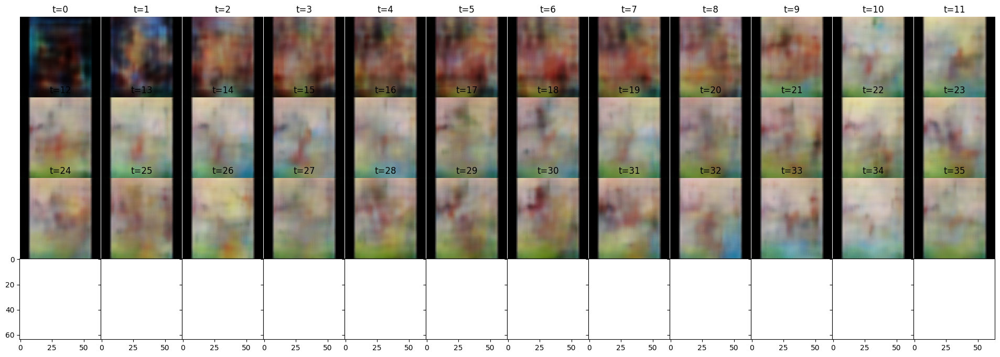

In [30]:
latents = torch.randn(2, 17, 384).to(device)
gen_sequence = []

for j in range(seq_len):    
    gen_frame = dinoLSTM(latents.unsqueeze(0))
    gen_sequence.append( gen_frame )
    next_latent = dinov2(gen_frame)
    next_latent = next_latent.last_hidden_state
    latents = torch.cat([latents, next_latent])
    
gen_sequnce_dinoLSTM = torch.cat(gen_sequence)

plot_frame_sequence(gen_sequnce_dinoLSTM, 4, 12, (24, 8))

convLSTM mean similarity tensor(0.1421)
dinoLSTM mean similarity tensor(0.1371)
convLSTM frames mean similarity tensor(0.0164)
dinoLSTM frames mean similarity tensor(0.0988)


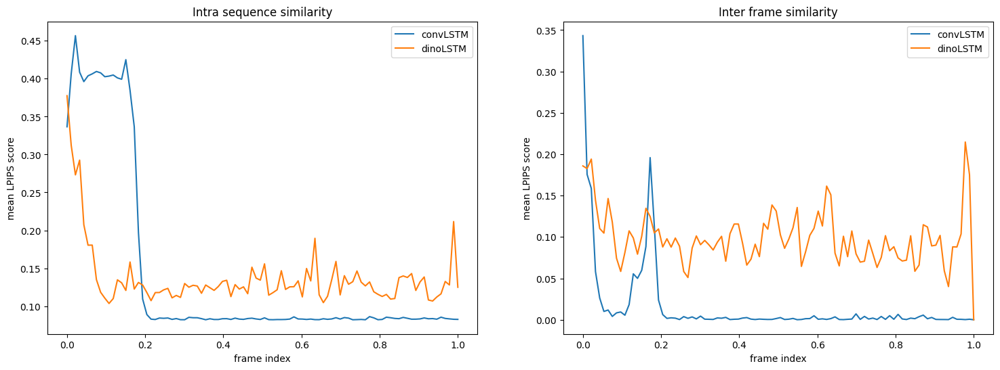

In [70]:
from torchmetrics.image import LearnedPerceptualImagePatchSimilarity

lpips = LearnedPerceptualImagePatchSimilarity(net_type='squeeze')
lpips = lpips.to(device)

convLSTM_seq_sim = intra_sequence_similarity(gen_sequnce_convLSTM, lpips)
dinoLSTM_seq_sim = intra_sequence_similarity(gen_sequnce_dinoLSTM, lpips)

print('convLSTM mean similarity', torch.mean(convLSTM_seq_sim))
print('dinoLSTM mean similarity',torch.mean(dinoLSTM_seq_sim))

convLSTM_frame_sim = inter_frame_similarity(gen_sequnce_convLSTM, lpips)
dinoLSTM_frame_sim = inter_frame_similarity(gen_sequnce_dinoLSTM, lpips)

print('convLSTM frames mean similarity', torch.mean(convLSTM_frame_sim))
print('dinoLSTM frames mean similarity',torch.mean(dinoLSTM_frame_sim))

x = np.linspace(0, 1, 94)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

ax1.plot(x, convLSTM_seq_sim, label='convLSTM')
ax1.plot(x, dinoLSTM_seq_sim, label='dinoLSTM')
ax1.set_title('Intra sequence similarity')
ax1.set_xlabel('frame index')
ax1.set_ylabel('mean LPIPS score')
ax1.legend()

ax2.plot(x, convLSTM_frame_sim, label='convLSTM')
ax2.plot(x, dinoLSTM_frame_sim, label='dinoLSTM')
ax2.set_title('Inter frame similarity')
ax2.set_xlabel('frame index')
ax2.set_ylabel('mean LPIPS score')
ax2.legend()

plt.show()

Dissapointgly again, we see both in intuitive and empirical analisys that the networks are unable to generate interesting long sequences of frames and apart from a short burst of different frames at the beginning, they quickly converge onto a single frame which is repeated. more over the clarity for most of the frames is not good enough to make out characters or scenes.


## Conclusion

With these results we move on to concluding remarks. In short, both models performed adequately at predicting the next frame but due to the poor reconstruction quality they where unable to continuously generate more frames and we could not observe the deeper insights they learned if they learned any at all.
This shows that the learning video data has a whole new set of challenges on top of mere image processing and that much effort, cleverness and training is required to get them to preform well. We saw this especially when observing the reconstruction quality of the simple convolutional autoencoder or decoder vs the decoders that where coupled with LSTMs. The mistakes of the LSTM can hinder the training of the decoder and vice versa.

### Takeaways

The main takeaways from these results are:
1. Having meaningful and consistent encoding of the image to a lower dimension helps a lot in sturctural reconstruction (as we saw with the dinov2 based decoder).
2. Having a relatively very small latent space aids in both variety and training aiding the network in finding the right weights much quicker.
3. A network that merely combines an LSTM and an convolutional decoder does not train very easily and better network architecture/training is needed in order to get better results
4. Trainig the encoder and decoder together results in better reconstruction quality.

### Suggestions for Future attempts

The results reached here where not completely satisfactory but they do point us in a couple of different directions that could lead to better results in future attempts.
One should investigate the correct size for a latent space, 128 may not be optimal depending on the complexity of the data and 17x384 is far too big even though dinoV2 produces excellent features.
One should also investigate the possibility of training the Convolutional LSTM in an adversarial training method since GANs hav been shown to achive very clear reconstruction quality when correctly trained.
Another approach that could yield better results is extracting features from the images analitically, using image processing algorithms, and then training just the lstm and decoder together. This may yield better results since feature encoding would be more consistent and there is plenty of room for experimentation with different feature extraction algorithms and hyperparameters.

### Short generated clip

Finally, a short clip which starts from dataset frames and continues with generated frames using the convLSTM model. 

In [ ]:
seq_len = 24
    
train_dataset.seq_len = seq_len
random_sample_idx = torch.randint(0, len(valid_dataset), (1,) ).item()
gen_sequence, _ = valid_dataset[random_sample_idx]

for j in range(seq_len*5):    
    gen_frame = convLSTM(gen_sequence[j:].unsqueeze(0).to(device))
    gen_sequence = torch.cat([gen_sequence, gen_frame.cpu()]) 

import imageio

to_pil = torchvision.transforms.ToPILImage()

images = [ to_pil(tensor2img(gen_sequence[j])) for j in range(seq_len)]

filenames = ['../tmp/image_{}.png'.format(i) for i in range(len(images))]
for image, filename in zip(images, filenames):
    image.save(filename)

# Create the GIF from the list of filenames
with imageio.get_writer('./img/output.gif', mode='I', loop=0, duration=0.5) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Remove the temporary image files
for filename in filenames:
    os.remove(filename)


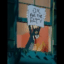

In [99]:
from IPython.display import HTML
import base64

with open('./img/output.gif', 'rb') as f:
    gif = f.read()

HTML(f'<img src="data:image/gif;base64,{base64.b64encode(gif).decode()}" width="640" >')